In [1]:
import numpy as np
import pandas as pd
import os
import seaborn as sns
import matplotlib.pyplot as plt
from PIL import Image
from pathlib import Path
from typing import List, Tuple, Dict
import tifffile
from tqdm import tqdm
import warnings
warnings.filterwarnings("ignore")

In [2]:
class KidneyVesselEDA:
    def __init__(self, base_path: str):
        """
        Initialize the EDA class
        
        Args:
            base_path (str): Path to the Kaggle dataset directory
        """
        self.base_path = Path(base_path)
        self.train_path = self.base_path / 'train'
        self.datasets = ['kidney_1_dense', 'kidney_1_voi', 'kidney_2', 
                        'kidney_3_dense', 'kidney_3_sparse']
        
    def load_dataset_info(self) -> Dict:
        """
        Load basic information about each dataset
        
        Returns:
            Dict: Dictionary containing dataset statistics
        """
        dataset_info = {}
        
        for dataset in self.datasets:
            dataset_path = self.train_path / dataset
            if dataset_path.exists():
                images_path = dataset_path / 'images'
                labels_path = dataset_path / 'labels'
                
                if images_path.exists():
                    n_images = len(list(images_path.glob('*.tif')))
                else:
                    n_images = 0
                    
                if labels_path.exists():
                    n_labels = len(list(labels_path.glob('*.tif')))
                else:
                    n_labels = 0
                
                # Get image dimensions from first image
                if n_images > 0:
                    first_image = tifffile.imread(str(next(images_path.glob('*.tif'))))
                    dimensions = first_image.shape
                else:
                    dimensions = None
                
                dataset_info[dataset] = {
                    'n_images': n_images,
                    'n_labels': n_labels,
                    'dimensions': dimensions
                }
        
        return dataset_info
    
    def analyze_class_distribution(self, dataset: str) -> Tuple[float, float]:
        """
        Analyze the class distribution (vessel vs non-vessel) in a dataset
        
        Args:
            dataset (str): Name of the dataset to analyze
            
        Returns:
            Tuple[float, float]: Percentage of vessel and non-vessel pixels
        """
        labels_path = self.train_path / dataset / 'labels'
        if not labels_path.exists():
            return None
            
        total_pixels = 0
        vessel_pixels = 0
        
        for label_file in tqdm(list(labels_path.glob('*.tif')), desc=f'Analyzing {dataset}'):
            mask = tifffile.imread(str(label_file))
            total_pixels += mask.size
            vessel_pixels += np.sum(mask > 0)
        
        vessel_percentage = (vessel_pixels / total_pixels) * 100
        non_vessel_percentage = 100 - vessel_percentage
        
        return vessel_percentage, non_vessel_percentage
    
    def visualize_sample_slices(self, dataset: str, n_samples: int = 5) -> None:
        """
        Visualize sample slices from a dataset with their corresponding masks
        
        Args:
            dataset (str): Name of the dataset to visualize
            n_samples (int): Number of samples to visualize
        """
        images_path = self.train_path / dataset / 'images'
        labels_path = self.train_path / dataset / 'labels'
        
        if not images_path.exists() or not labels_path.exists():
            print(f"Dataset {dataset} not found or incomplete")
            return
            
        image_files = sorted(list(images_path.glob('*.tif')))
        label_files = sorted(list(labels_path.glob('*.tif')))
        
        # Select evenly spaced samples
        indices = np.linspace(0, len(image_files)-1, n_samples, dtype=int)
        
        fig, axes = plt.subplots(n_samples, 2, figsize=(10, 3*n_samples))
        fig.suptitle(f'Sample Slices from {dataset}')
        
        for idx, (ax_row, i) in enumerate(zip(axes, indices)):
            # Load image and mask
            image = tifffile.imread(str(image_files[i]))
            mask = tifffile.imread(str(label_files[i]))
            
            # Display image
            ax_row[0].imshow(image, cmap='gray')
            ax_row[0].set_title(f'Slice {str(image_files[i]).split("/")[-1]}')
            ax_row[0].axis('off')
            
            # Display mask
            ax_row[1].imshow(mask, cmap='binary')
            ax_row[1].set_title(f'Mask {str(label_files[i]).split("/")[-1]}')
            ax_row[1].axis('off')
        
        plt.tight_layout()
        plt.show()
    
    def plot_class_distribution(self, distribution_data: Dict) -> None:
        """
        Plot the class distribution across datasets
        
        Args:
            distribution_data (Dict): Dictionary containing class distribution data
        """
        datasets = list(distribution_data.keys())
        vessel_percentages = [d[0] for d in distribution_data.values()]
        non_vessel_percentages = [d[1] for d in distribution_data.values()]
        
        fig, ax = plt.subplots(figsize=(12, 6))
        width = 0.35
        
        ax.bar(datasets, vessel_percentages, width, label='Vessel')
        ax.bar(datasets, non_vessel_percentages, width, bottom=vessel_percentages, label='Non-vessel')
        
        ax.set_ylabel('Percentage')
        ax.set_title('Class Distribution Across Datasets')
        ax.legend()
        
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()


Analyzing dataset information...

Dataset Statistics:

kidney_1_dense:
  Number of images: 2279
  Number of labels: 2279
  Image dimensions: (1303, 912)

kidney_1_voi:
  Number of images: 1397
  Number of labels: 1397
  Image dimensions: (1928, 1928)

kidney_2:
  Number of images: 2217
  Number of labels: 2217
  Image dimensions: (1041, 1511)

kidney_3_dense:
  Number of images: 0
  Number of labels: 501
  Image dimensions: None

kidney_3_sparse:
  Number of images: 1035
  Number of labels: 1035
  Image dimensions: (1706, 1510)

Analyzing class distribution...


Analyzing kidney_1_dense: 100%|██████████| 2279/2279 [00:58<00:00, 38.71it/s]



kidney_1_dense:
  Vessel pixels: 0.62%
  Non-vessel pixels: 99.38%


Analyzing kidney_1_voi: 100%|██████████| 1397/1397 [01:03<00:00, 22.00it/s]



kidney_1_voi:
  Vessel pixels: 1.18%
  Non-vessel pixels: 98.82%


Analyzing kidney_2: 100%|██████████| 2217/2217 [01:04<00:00, 34.24it/s]



kidney_2:
  Vessel pixels: 0.41%
  Non-vessel pixels: 99.59%


Analyzing kidney_3_dense: 100%|██████████| 501/501 [00:16<00:00, 30.20it/s]



kidney_3_dense:
  Vessel pixels: 0.23%
  Non-vessel pixels: 99.77%


Analyzing kidney_3_sparse: 100%|██████████| 1035/1035 [00:33<00:00, 30.53it/s]



kidney_3_sparse:
  Vessel pixels: 0.27%
  Non-vessel pixels: 99.73%


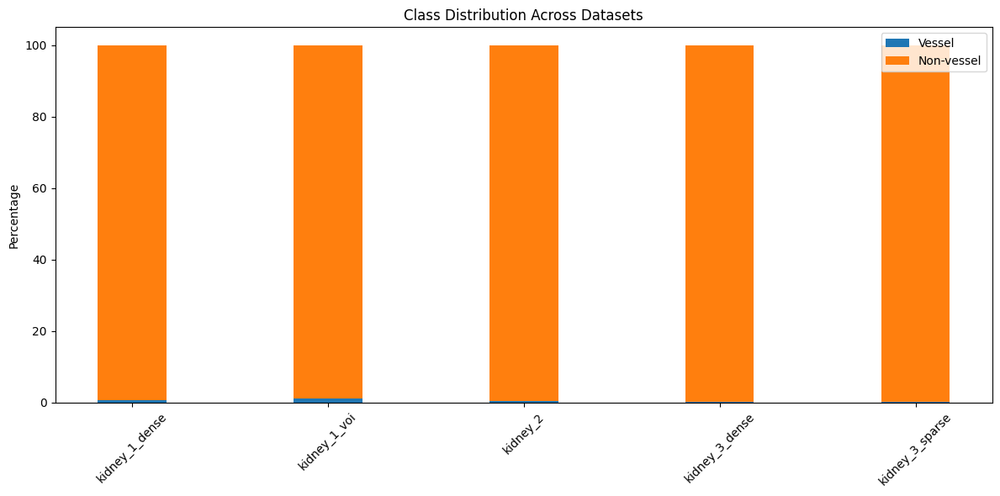


Visualizing sample slices...

Visualizing kidney_1_dense...


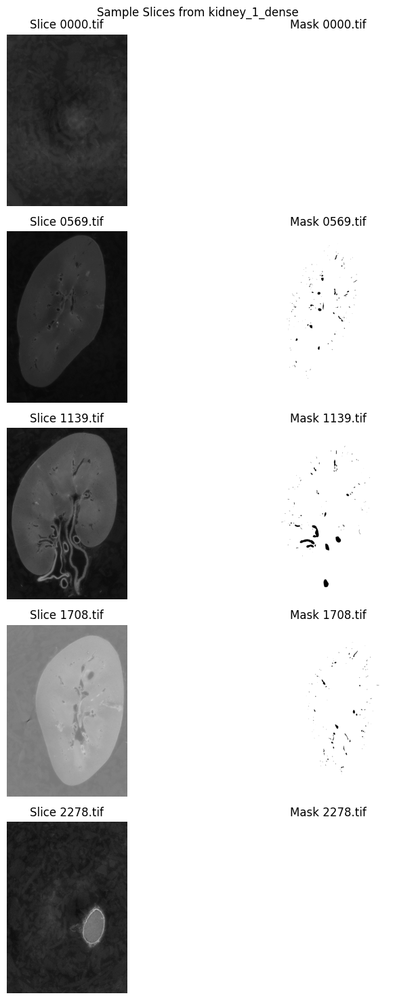


Visualizing kidney_1_voi...


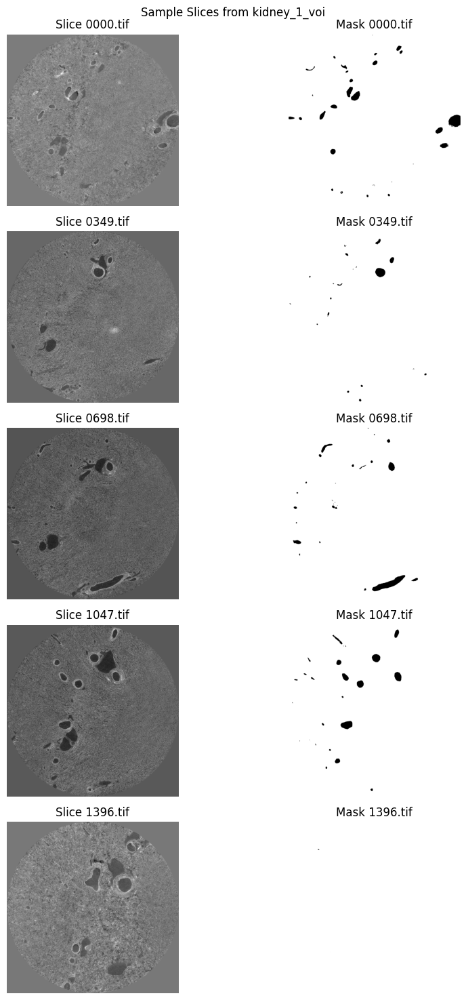


Visualizing kidney_2...


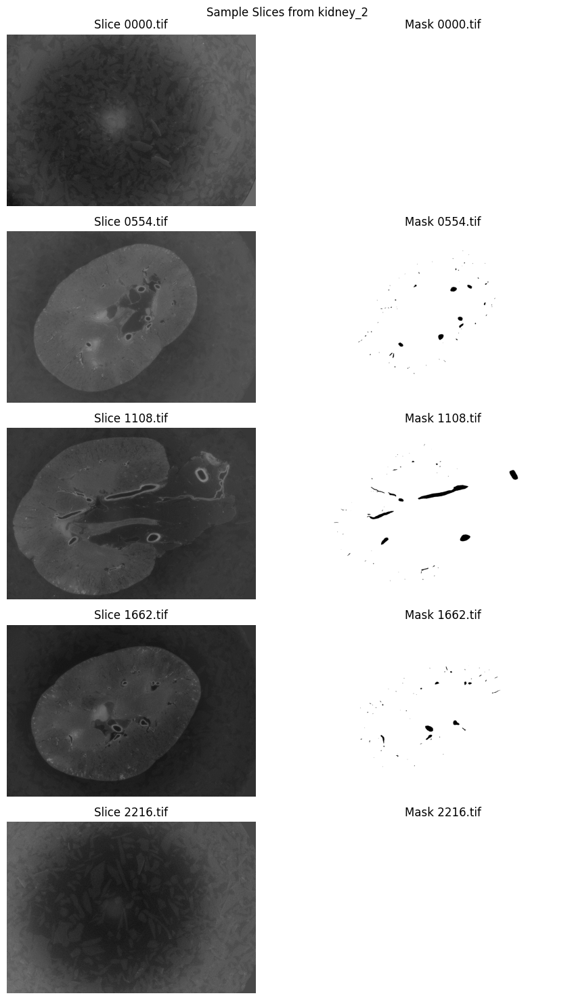


Visualizing kidney_3_dense...
Dataset kidney_3_dense not found or incomplete

Visualizing kidney_3_sparse...


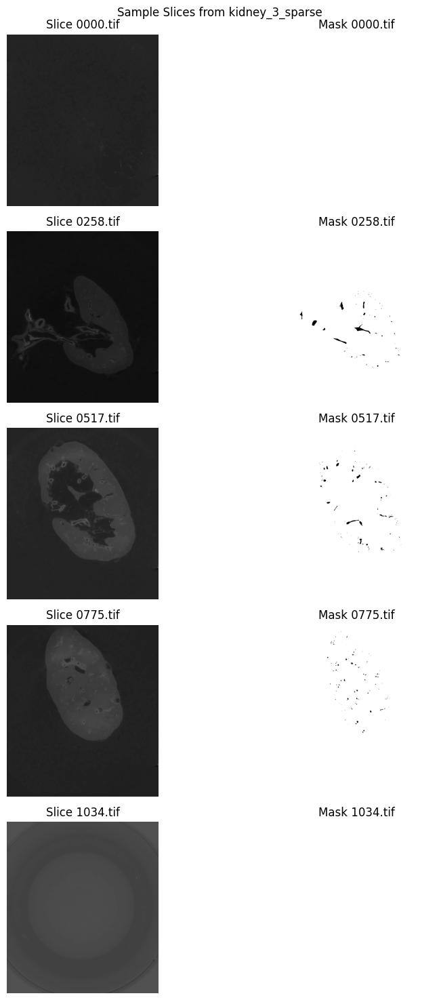

In [3]:
def main():
    # Initialize EDA class with Kaggle dataset path
    kaggle_path = '/kaggle/input/blood-vessel-segmentation'
    eda = KidneyVesselEDA(kaggle_path)
    
    # Get dataset information
    print("Analyzing dataset information...")
    dataset_info = eda.load_dataset_info()
    
    # Print dataset statistics
    print("\nDataset Statistics:")
    for dataset, info in dataset_info.items():
        print(f"\n{dataset}:")
        print(f"  Number of images: {info['n_images']}")
        print(f"  Number of labels: {info['n_labels']}")
        print(f"  Image dimensions: {info['dimensions']}")
    
    # Analyze class distribution for training datasets
    print("\nAnalyzing class distribution...")
    distribution_data = {}
    for dataset in eda.datasets:
        if dataset_info[dataset]['n_labels'] > 0:
            distribution = eda.analyze_class_distribution(dataset)
            if distribution:
                distribution_data[dataset] = distribution
                print(f"\n{dataset}:")
                print(f"  Vessel pixels: {distribution[0]:.2f}%")
                print(f"  Non-vessel pixels: {distribution[1]:.2f}%")
    
    # Plot class distribution
    eda.plot_class_distribution(distribution_data)
    
    # Visualize sample slices from each dataset
    print("\nVisualizing sample slices...")
    for dataset in eda.datasets:
        if dataset_info[dataset]['n_labels'] > 0:
            print(f"\nVisualizing {dataset}...")
            eda.visualize_sample_slices(dataset)

if __name__ == "__main__":
    main()

In [6]:
train_df = pd.read_csv("/kaggle/input/blood-vessel-segmentation/train_rles.csv")
train_df.head()

,id,rle
0,kidney_1_dense_0000,1 0
1,kidney_1_dense_0001,1 0
2,kidney_1_dense_0002,1 0
3,kidney_1_dense_0003,1 0
4,kidney_1_dense_0004,1 0


# Data Preprocessing

In [7]:
!pip install -q -U albumentations

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.5/41.5 kB 2.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.0/66.0 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 289.6/289.6 kB 14.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 632.7/632.7 kB 31.6 MB/s eta 0:00:00


In [8]:
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
import numpy as np
import tifffile
from pathlib import Path
from typing import Tuple, List, Dict, Optional
from scipy.ndimage import binary_dilation, binary_closing
import albumentations as A
from tqdm import tqdm
import os
import gc
import matplotlib.pyplot as plt
import cv2
from sklearn.model_selection import train_test_split
import json
import warnings
warnings.filterwarnings("ignore")

In [9]:
def clear_memory():
    """Aggressively clear memory"""
    plt.close('all')
    gc.collect()

In [10]:
class_weights = {
    'kidney_1_dense': {'dice_weight': 0.7, 'bce_weight': 0.3},
    'kidney_1_voi': {'dice_weight': 0.6, 'bce_weight': 0.4},
    'kidney_2': {'dice_weight': 0.7, 'bce_weight': 0.3},
    'kidney_3_sparse': {'dice_weight': 0.8, 'bce_weight': 0.2}
}

In [11]:
class VesselDataset(Dataset):
    """
    Dataset class for vessel segmentation data
    """
    def __init__(self, 
                 image_files: List[Path], 
                 label_files: List[Path], 
                 transform: Optional[A.Compose] = None, 
                 size: Tuple[int, int] = (512, 512)):
        """
        Initialize the dataset
        
        Args:
            image_files (List[Path]): List of paths to image files
            label_files (List[Path]): List of paths to label files
            transform (Optional[A.Compose]): Albumentations transforms to apply
            size (Tuple[int, int]): Target size for resizing (height, width)
        """
        self.image_files = image_files
        self.label_files = label_files
        self.transform = transform
        self.target_h, self.target_w = size
        
        # Validate files
        self._validate_files()
        
        # Get original dimensions from first image
        try:
            first_image = tifffile.imread(str(image_files[0]))
            orig_h, orig_w = first_image.shape
            print(f"Dataset: Original dimensions: {orig_h}x{orig_w}, Target dimensions: {self.target_h}x{self.target_w}")
            
            # Clear memory
            del first_image
            gc.collect()
            
        except Exception as e:
            print(f"Warning: Could not read first image: {str(e)}")
    
    def _validate_files(self):
        """Validate that all files exist and match"""
        if len(self.image_files) != len(self.label_files):
            raise ValueError(f"Number of images ({len(self.image_files)}) "
                           f"!= number of labels ({len(self.label_files)})")
        
        # Check all files exist
        for img_path, label_path in zip(self.image_files, self.label_files):
            if not Path(img_path).exists():
                raise FileNotFoundError(f"Image file not found: {img_path}")
            if not Path(label_path).exists():
                raise FileNotFoundError(f"Label file not found: {label_path}")
    
    def __len__(self) -> int:
        """Return the total number of samples"""
        return len(self.image_files)
    
    def preprocess_image(self, 
                        image: np.ndarray, 
                        is_mask: bool = False) -> np.ndarray:
        """
        Preprocess image to target size
        
        Args:
            image (np.ndarray): Input image or mask
            is_mask (bool): Whether the input is a mask
            
        Returns:
            np.ndarray: Preprocessed image or mask
        """
        try:
            if is_mask:
                # Use nearest neighbor for masks to preserve binary values
                processed = cv2.resize(
                    image.astype(np.uint8),
                    (self.target_w, self.target_h),
                    interpolation=cv2.INTER_NEAREST
                )
            else:
                # Use bilinear interpolation for images
                processed = cv2.resize(
                    image.astype(np.float32),
                    (self.target_w, self.target_h),
                    interpolation=cv2.INTER_LINEAR
                )
            return processed
            
        except Exception as e:
            print(f"Error in preprocessing: {str(e)}")
            # Return zero array of correct shape and type
            return np.zeros((self.target_h, self.target_w), 
                          dtype=np.uint8 if is_mask else np.float32)
    
    def normalize_image(self, image: np.ndarray) -> np.ndarray:
        """
        Normalize image to [0,1] range with safe division
        
        Args:
            image (np.ndarray): Input image
            
        Returns:
            np.ndarray: Normalized image
        """
        try:
            image_min = image.min()
            image_max = image.max()
            
            if image_max - image_min == 0:
                return np.zeros_like(image, dtype=np.float32)
                
            return (image - image_min) / (image_max - image_min)
            
        except Exception as e:
            print(f"Error in normalization: {str(e)}")
            return np.zeros_like(image, dtype=np.float32)
    
    def __getitem__(self, idx: int) -> Tuple[torch.Tensor, torch.Tensor]:
        """
        Get a sample from the dataset
        
        Args:
            idx (int): Index of the sample
            
        Returns:
            Tuple[torch.Tensor, torch.Tensor]: Image and mask tensors
        """
        try:
            # Load image and mask with memory management
            image = tifffile.imread(str(self.image_files[idx]))
            mask = tifffile.imread(str(self.label_files[idx]))
            
            # Basic input validation
            if image is None or mask is None:
                raise ValueError("Failed to load image or mask")
            
            if image.size == 0 or mask.size == 0:
                raise ValueError("Empty image or mask")
            
            # Normalize image
            image = self.normalize_image(image)
            
            # Convert mask to binary
            mask = (mask > 0).astype(np.uint8)
            
            # Resize both to target size
            image = self.preprocess_image(image, is_mask=False)
            mask = self.preprocess_image(mask, is_mask=True)
            
            # Apply transforms if specified
            if self.transform:
                transformed = self.transform(
                    image=image.astype(np.float32),
                    mask=mask
                )
                image = transformed['image']
                mask = transformed['mask']
            
            # Convert to tensors
            image = torch.from_numpy(image).float().unsqueeze(0)
            mask = torch.from_numpy(mask).float().unsqueeze(0)
            
            # Validate output tensors
            if torch.isnan(image).any() or torch.isnan(mask).any():
                raise ValueError("NaN values in output tensors")
            
            # Clear memory
            gc.collect()
            
            return image, mask
            
        except Exception as e:
            print(f"Error loading sample {idx} from {self.image_files[idx]}: {str(e)}")
            # Return zero tensors in case of error
            return (torch.zeros((1, self.target_h, self.target_w), dtype=torch.float32),
                   torch.zeros((1, self.target_h, self.target_w), dtype=torch.float32))
    
    def get_class_weights(self) -> Tuple[float, float]:
        """
        Calculate class weights based on the full dataset
        
        Returns:
            Tuple[float, float]: Weights for background and vessel classes
        """
        try:
            total_pixels = 0
            vessel_pixels = 0
            
            for label_file in self.label_files:
                mask = tifffile.imread(str(label_file))
                total_pixels += mask.size
                vessel_pixels += np.sum(mask > 0)
            
            background_pixels = total_pixels - vessel_pixels
            
            # Calculate weights (inverse frequency)
            background_weight = 1.0
            vessel_weight = (background_pixels / vessel_pixels) if vessel_pixels > 0 else 1.0
            
            return background_weight, vessel_weight
            
        except Exception as e:
            print(f"Error calculating class weights: {str(e)}")
            return 1.0, 1.0

In [12]:
def get_train_transforms(dataset_name):
    """Get improved but safer augmentation transforms"""
    # Base transforms for all datasets
    base_transforms = [
        A.RandomRotate90(p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
        A.ShiftScaleRotate(
            shift_limit=0.0625,
            scale_limit=0.1, 
            rotate_limit=30,
            p=0.5,
            border_mode=cv2.BORDER_CONSTANT
        )
    ]
    
    # Dataset-specific transforms (simplified)
    if 'sparse' in dataset_name:
        base_transforms.extend([
            A.GaussNoise(var_limit=(10.0, 30.0), p=0.3),
            A.RandomBrightnessContrast(p=0.3)
        ])
    
    if 'dense' in dataset_name:
        base_transforms.extend([
            A.RandomBrightnessContrast(p=0.3),
            A.CLAHE(clip_limit=2, p=0.3)
        ])
    
    # Add normalization as final transform
    base_transforms.append(
        A.Normalize(mean=[0.485], std=[0.229], max_pixel_value=1.0, p=1.0)
    )
    
    return A.Compose(base_transforms)

In [13]:
def get_val_transforms():
    return A.Compose([
        A.Normalize(mean=[0.485], std=[0.229], max_pixel_value=1.0),
    ])

In [14]:
def process_dataset(kaggle_path: Path, dataset_name: str, target_size=(512, 512)) -> Tuple[DataLoader, DataLoader]:
    """Process dataset and create train/val splits"""
    print(f"\nProcessing {dataset_name}")
    
    try:
        # Setup paths
        images_path = kaggle_path / 'train' / dataset_name / 'images'
        labels_path = kaggle_path / 'train' / dataset_name / 'labels'
        
        if not images_path.exists() or not labels_path.exists():
            print(f"Required directories not found for {dataset_name}")
            return None, None
        
        # Get files and match them
        image_files = sorted(list(images_path.glob('*.tif')))
        label_files = []
        
        # Match files by index
        for img_file in image_files:
            img_idx = int(img_file.stem)
            matching_label = labels_path / f"{img_idx:04d}.tif"
            if matching_label.exists():
                label_files.append(matching_label)
        
        # Keep only images with matching labels
        image_files = image_files[:len(label_files)]
        
        if len(image_files) == 0:
            print(f"No matching pairs found for {dataset_name}")
            return None, None
        
        print(f"Found {len(image_files)} matching pairs")
        
        # Split into train and validation
        train_images, val_images, train_labels, val_labels = train_test_split(
            image_files, label_files,
            test_size=0.2,
            random_state=42
        )
        
        # Create datasets with fixed size
        train_dataset = VesselDataset(
            train_images,
            train_labels,
            transform=get_train_transforms(dataset_name),
            size=target_size
        )
        
        val_dataset = VesselDataset(
            val_images,
            val_labels,
            transform=get_val_transforms(),
            size=target_size
        )
        
        # Create dataloaders
        train_loader = DataLoader(
            train_dataset,
            batch_size=4,
            shuffle=True,
            num_workers=0,
            pin_memory=True
        )
        
        val_loader = DataLoader(
            val_dataset,
            batch_size=4,
            shuffle=False,
            num_workers=0,
            pin_memory=True
        )
        
        print(f"Created train dataloader with {len(train_dataset)} samples")
        print(f"Created val dataloader with {len(val_dataset)} samples")
        
        return train_loader, val_loader
        
    except Exception as e:
        print(f"Error processing {dataset_name}: {str(e)}")
        gc.collect()
        return None, None

In [15]:
def create_overlay(image, mask, alpha=0.5):
    """Create overlay of mask on image"""
    # Ensure proper types
    image = image.astype(np.float32)
    mask = mask.astype(bool)
    
    # Create RGB version of grayscale image
    rgb_image = np.stack([image] * 3, axis=-1)
    
    # Create red mask overlay
    red_mask = np.zeros_like(rgb_image)
    red_mask[mask] = [1, 0, 0]  # Red color for mask
    
    # Combine image and mask
    overlay = (1 - alpha) * rgb_image + alpha * red_mask
    
    # Ensure values are in valid range
    overlay = np.clip(overlay, 0, 1)
    
    return overlay

In [16]:
def visualize_processed_dataset(images_path: Path, labels_path: Path, dataset_name: str, num_samples: int = 3):
    """Visualize samples from dataset including augmentations"""
    try:
        image_files = sorted(list(images_path.glob('*.tif')))
        label_files = sorted(list(labels_path.glob('*.tif')))
        
        if len(image_files) == 0 or len(label_files) == 0:
            print(f"No images or masks found for {dataset_name}")
            return
            
        # Select evenly spaced samples
        indices = np.linspace(0, len(image_files)-1, num_samples, dtype=int)
        
        # Get transforms
        train_transform = get_train_transforms(dataset_name)
        
        for idx in indices:
            # Load images with memory management
            with warnings.catch_warnings():
                warnings.simplefilter("ignore")
                
                # Load and preprocess image
                image = tifffile.imread(str(image_files[idx]))
                image = (image - image.min()) / (image.max() - image.min())
                
                # Load and preprocess mask - keep as uint8
                mask = tifffile.imread(str(label_files[idx]))
                mask = (mask > 0).astype(np.uint8)  # Convert to uint8 instead of bool
                
                # Apply augmentation
                try:
                    augmented = train_transform(image=image.astype(np.float32), 
                                             mask=mask)
                    aug_image = augmented['image']
                    aug_mask = augmented['mask']
                except Exception as e:
                    print(f"Augmentation error: {str(e)}")
                    continue
                
                # Create figure with two rows
                fig, axes = plt.subplots(2, 3, figsize=(15, 10))
                fig.suptitle(f'{dataset_name} - Sample {idx}')
                
                # Original images row
                axes[0, 0].imshow(image, cmap='gray')
                axes[0, 0].set_title('Original')
                axes[0, 0].axis('off')
                
                axes[0, 1].imshow(mask, cmap='Reds')
                axes[0, 1].set_title('Original Mask')
                axes[0, 1].axis('off')
                
                # Create and show original overlay
                overlay = create_overlay(image, mask)
                axes[0, 2].imshow(overlay)
                axes[0, 2].set_title('Original Overlay')
                axes[0, 2].axis('off')
                
                # Augmented images row
                axes[1, 0].imshow(aug_image, cmap='gray')
                axes[1, 0].set_title('Augmented')
                axes[1, 0].axis('off')
                
                axes[1, 1].imshow(aug_mask, cmap='Reds')
                axes[1, 1].set_title('Augmented Mask')
                axes[1, 1].axis('off')
                
                # Create and show augmented overlay
                aug_overlay = create_overlay(aug_image, aug_mask.astype(bool))
                axes[1, 2].imshow(aug_overlay)
                axes[1, 2].set_title('Augmented Overlay')
                axes[1, 2].axis('off')
                
                plt.tight_layout()
                plt.show()
                plt.close()
                
            # Clear memory after each sample
            gc.collect()
                
    except Exception as e:
        print(f"Error in visualization: {str(e)}")
        gc.collect()


In [17]:
def save_dataloader_info(dataloaders, save_dir):
    """
    Save dataloader configurations and splits for each dataset
    """
    save_dir = Path(save_dir)
    save_dir.mkdir(parents=True, exist_ok=True)
    
    dataset_info = {}
    
    for dataset_name, loaders in dataloaders.items():
        # Get file paths from datasets
        train_dataset = loaders['train'].dataset
        val_dataset = loaders['val'].dataset
        
        dataset_info[dataset_name] = {
            'train': {
                'image_files': [str(path) for path in train_dataset.image_files],
                'label_files': [str(path) for path in train_dataset.label_files],
            },
            'val': {
                'image_files': [str(path) for path in val_dataset.image_files],
                'label_files': [str(path) for path in val_dataset.label_files],
            },
            'config': {
                'batch_size': loaders['train'].batch_size,
                'num_workers': loaders['train'].num_workers,
                'pin_memory': loaders['train'].pin_memory,
            }
        }
    
    # Save to JSON file
    with open(save_dir / 'dataloader_info.json', 'w') as f:
        json.dump(dataset_info, f, indent=4)
    
    print(f"\nDataloader information saved to {save_dir / 'dataloader_info.json'}")


In [18]:
def load_and_recreate_dataloaders(save_dir):
    """
    Recreate dataloaders from saved information
    """
    save_dir = Path(save_dir)
    
    # Load saved information
    with open(save_dir / 'dataloader_info.json', 'r') as f:
        dataset_info = json.load(f)
    
    dataloaders = {}
    
    for dataset_name, info in dataset_info.items():
        # Create train dataset
        train_dataset = VesselDataset(
            image_files=[Path(p) for p in info['train']['image_files']],
            label_files=[Path(p) for p in info['train']['label_files']],
            transform=get_train_transforms(dataset_name)
        )
        
        # Create val dataset
        val_dataset = VesselDataset(
            image_files=[Path(p) for p in info['val']['image_files']],
            label_files=[Path(p) for p in info['val']['label_files']],
            transform=get_val_transforms()
        )
        
        # Create dataloaders
        config = info['config']
        train_loader = DataLoader(
            train_dataset,
            batch_size=config['batch_size'],
            shuffle=True,
            num_workers=config['num_workers'],
            pin_memory=config['pin_memory']
        )
        
        val_loader = DataLoader(
            val_dataset,
            batch_size=config['batch_size'],
            shuffle=False,
            num_workers=config['num_workers'],
            pin_memory=config['pin_memory']
        )
        
        dataloaders[dataset_name] = {
            'train': train_loader,
            'val': val_loader
        }
    
    print("\nDataloaders recreated successfully!")
    return dataloaders


In [19]:
def verify_saved_dataloaders(original_loaders, recreated_loaders):
    """Verify that recreated dataloaders match the original ones"""
    print("\nVerifying recreated dataloaders:")
    print("=" * 50)
    
    for dataset_name in original_loaders.keys():
        print(f"\nDataset: {dataset_name}")
        
        orig_train = original_loaders[dataset_name]['train']
        new_train = recreated_loaders[dataset_name]['train']
        
        orig_val = original_loaders[dataset_name]['val']
        new_val = recreated_loaders[dataset_name]['val']
        
        print(f"Train samples - Original: {len(orig_train.dataset)}, Recreated: {len(new_train.dataset)}")
        print(f"Val samples - Original: {len(orig_val.dataset)}, Recreated: {len(new_val.dataset)}")
        
        # Verify first batch shapes
        try:
            orig_batch = next(iter(orig_train))
            new_batch = next(iter(new_train))
            
            print("Batch shapes:")
            print(f"Original - Images: {orig_batch[0].shape}, Masks: {orig_batch[1].shape}")
            print(f"Recreated - Images: {new_batch[0].shape}, Masks: {new_batch[1].shape}")
            print("Shapes match:", 
                  orig_batch[0].shape == new_batch[0].shape and 
                  orig_batch[1].shape == new_batch[1].shape)
            
        except Exception as e:
            print(f"Error checking batch shapes: {str(e)}")
            continue

In [20]:
def save_dataloaders_main(dataloaders):
    """Save and verify dataloaders"""
    # Save directory
    save_dir = Path('/kaggle/working/dataloader_info')
    
    # Save dataloader information
    save_dataloader_info(dataloaders, save_dir)
    
    # Recreate dataloaders to verify
    recreated_loaders = load_and_recreate_dataloaders(save_dir)
    
    # Verify recreated dataloaders
    verify_saved_dataloaders(dataloaders, recreated_loaders)

Starting Preprocessing Pipeline

Processing kidney_1_dense
------------------------------

Processing kidney_1_dense
Found 2279 matching pairs
Dataset: Original dimensions: 1303x912, Target dimensions: 512x512
Dataset: Original dimensions: 1303x912, Target dimensions: 512x512
Created train dataloader with 1823 samples
Created val dataloader with 456 samples

Displaying samples from kidney_1_dense


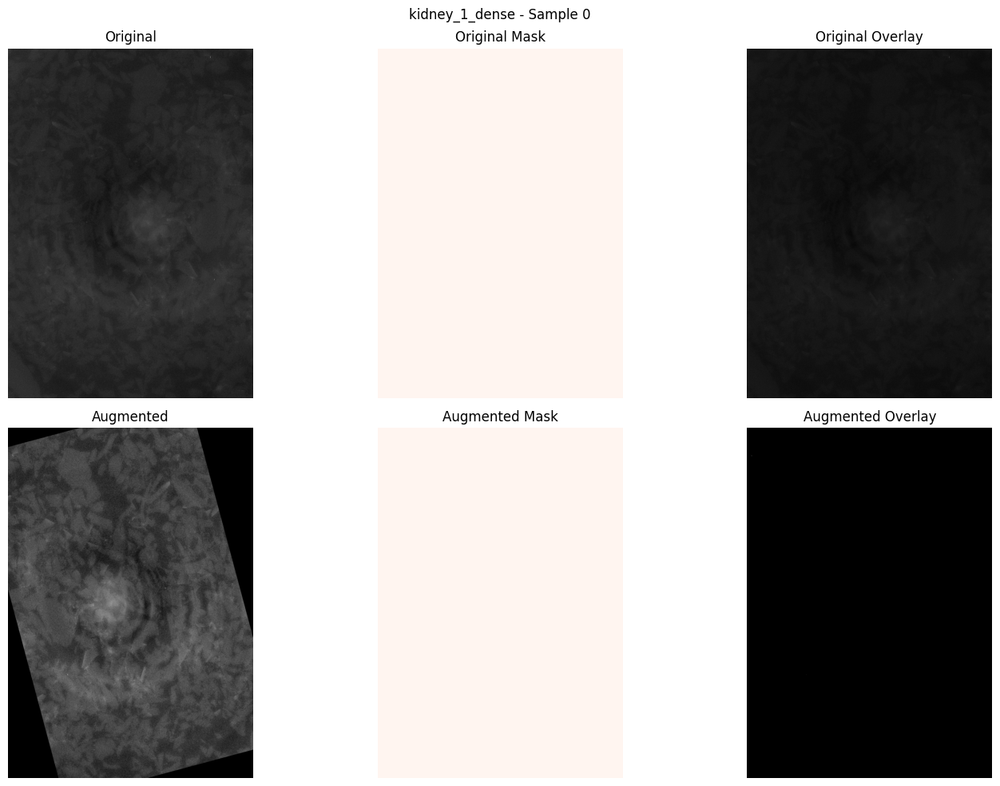

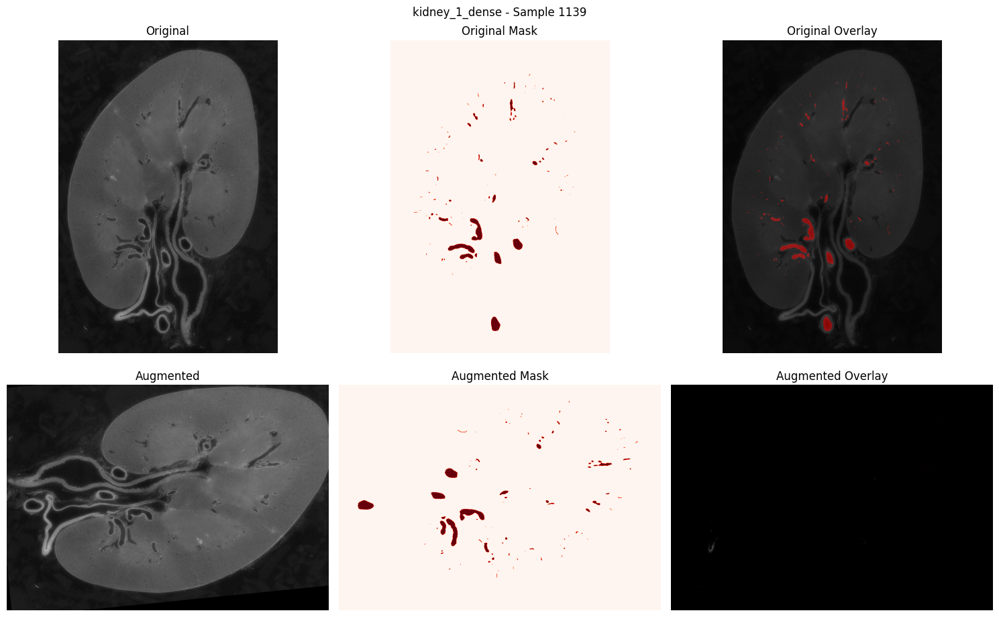

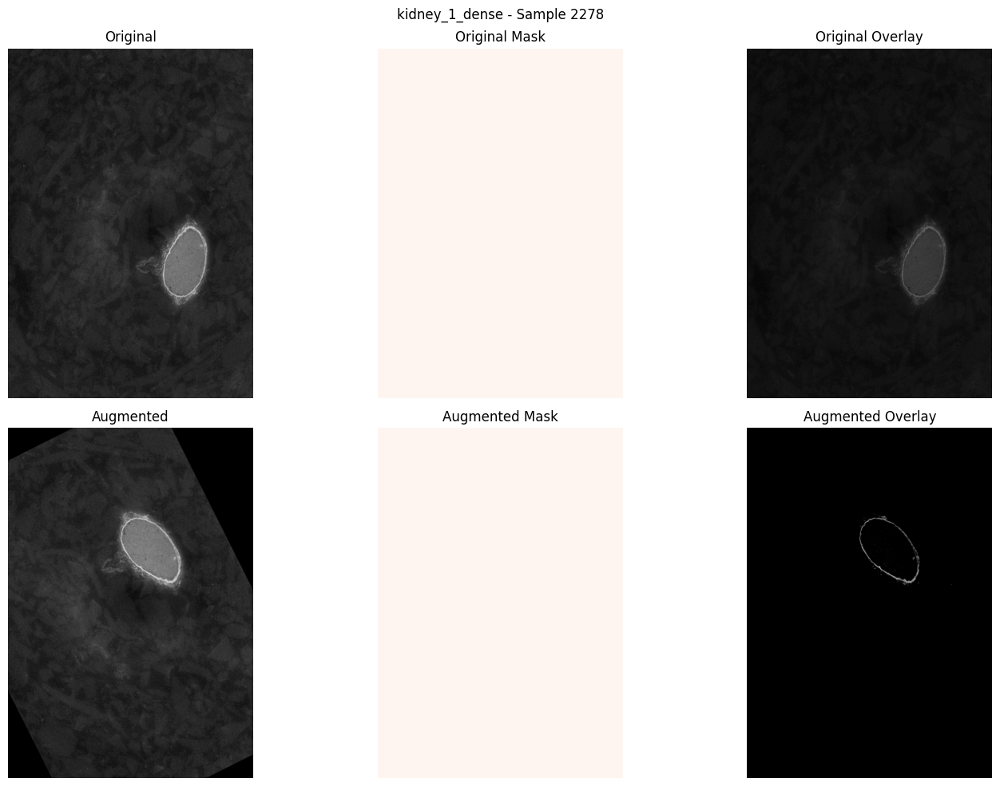

Visualization completed for kidney_1_dense

Processing kidney_1_voi
------------------------------

Processing kidney_1_voi
Found 1397 matching pairs
Dataset: Original dimensions: 1928x1928, Target dimensions: 512x512
Dataset: Original dimensions: 1928x1928, Target dimensions: 512x512
Created train dataloader with 1117 samples
Created val dataloader with 280 samples

Displaying samples from kidney_1_voi


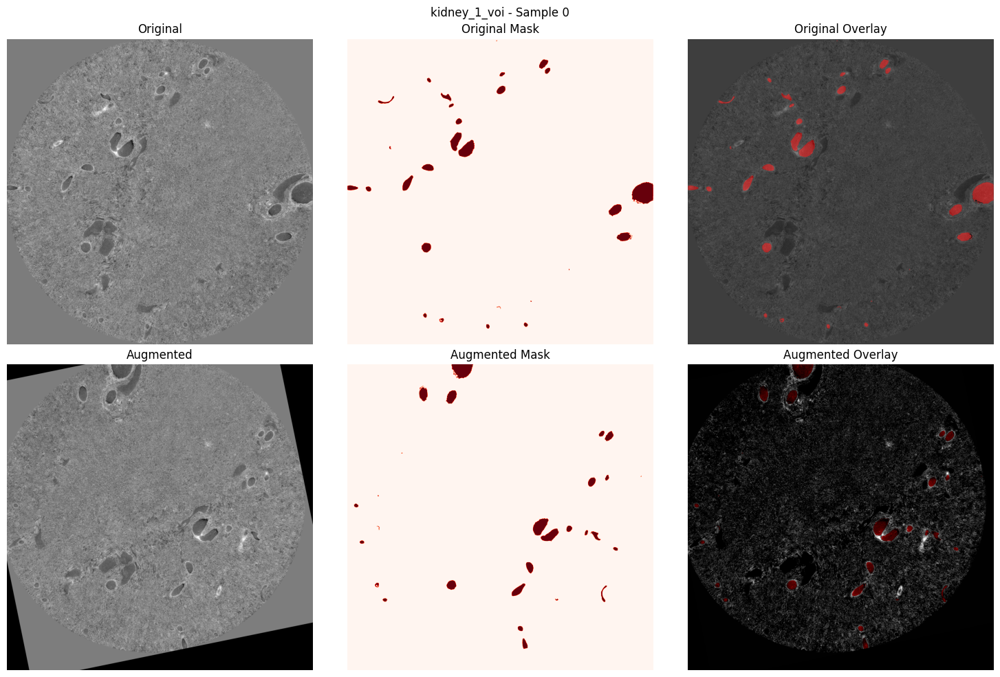

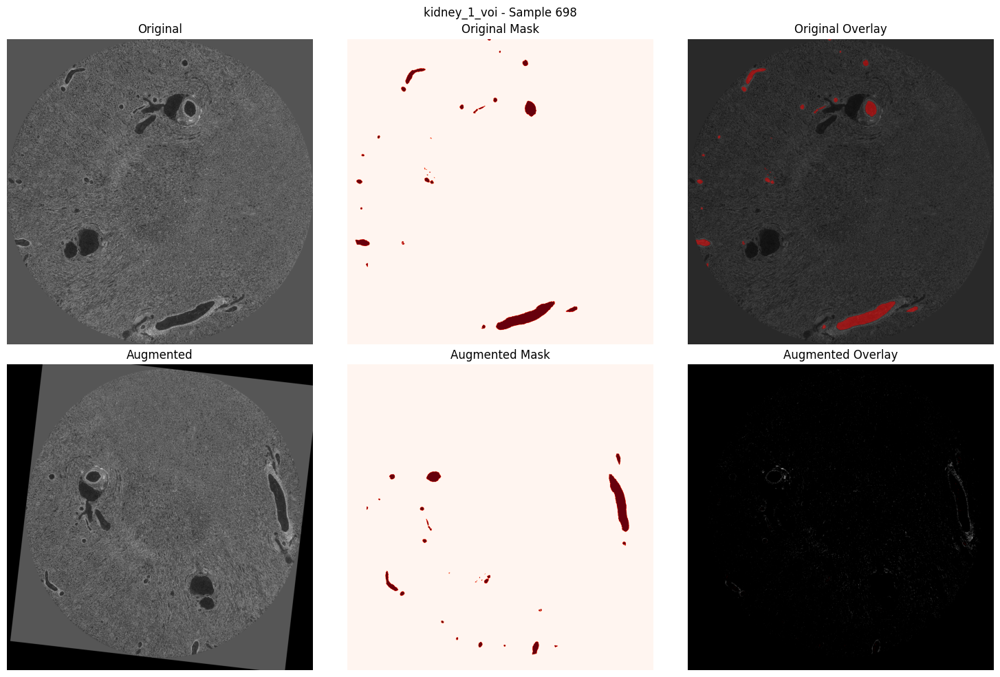

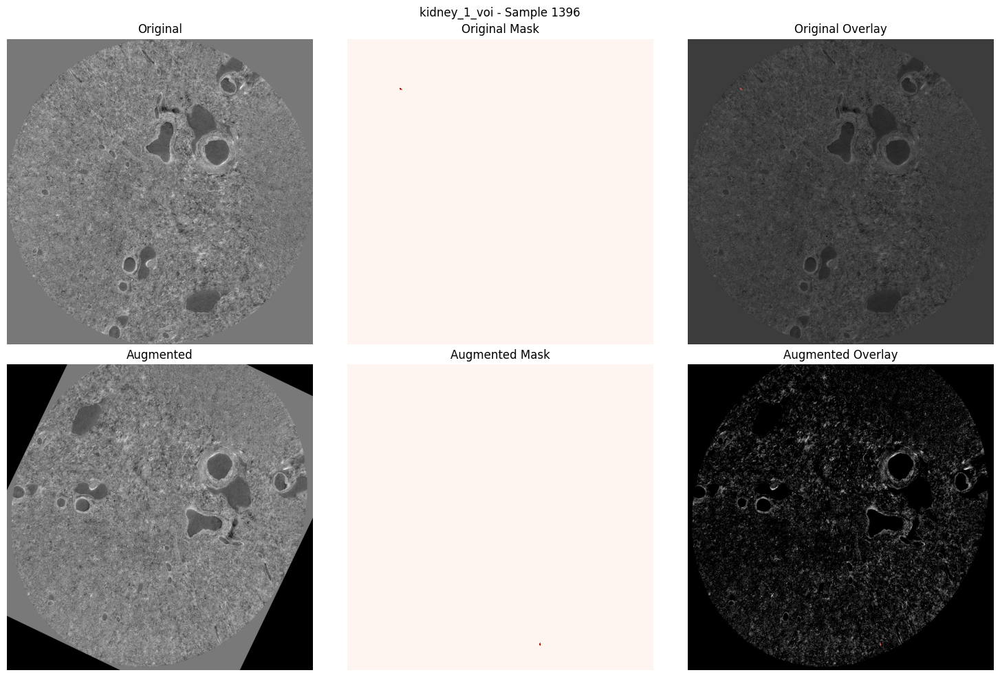

Visualization completed for kidney_1_voi

Processing kidney_2
------------------------------

Processing kidney_2
Found 2217 matching pairs
Dataset: Original dimensions: 1041x1511, Target dimensions: 512x512
Dataset: Original dimensions: 1041x1511, Target dimensions: 512x512
Created train dataloader with 1773 samples
Created val dataloader with 444 samples

Displaying samples from kidney_2


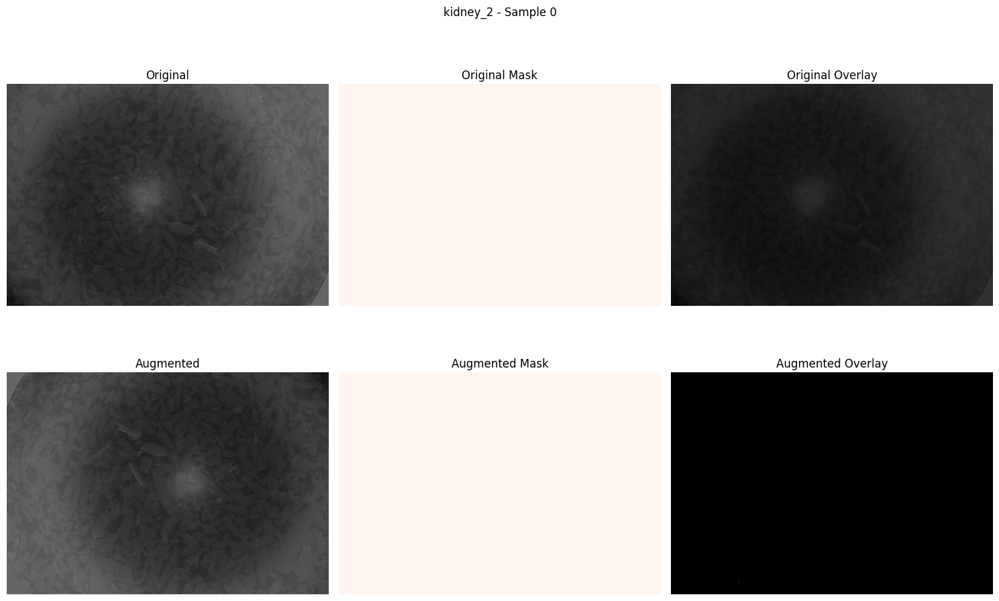

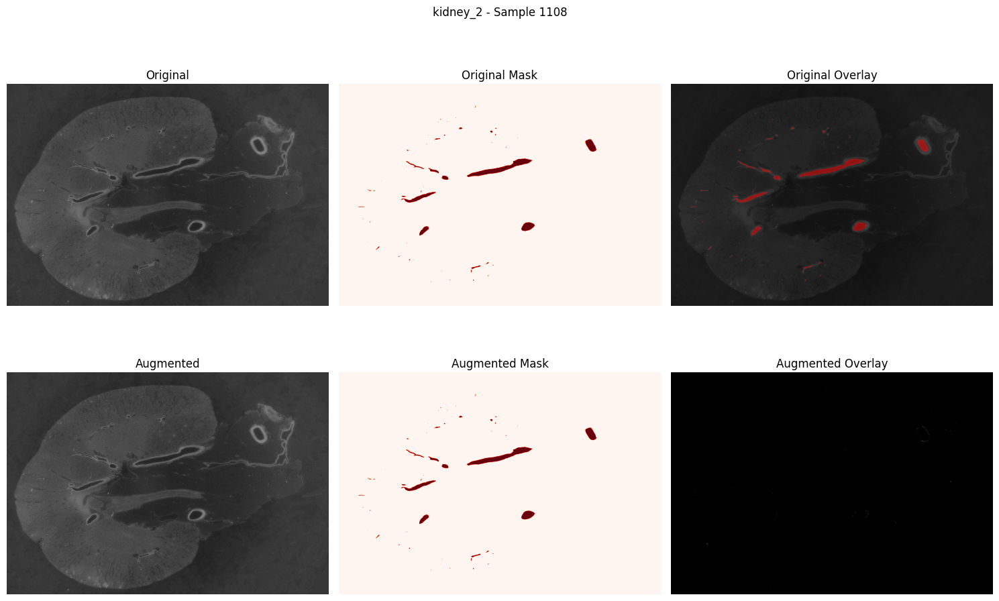

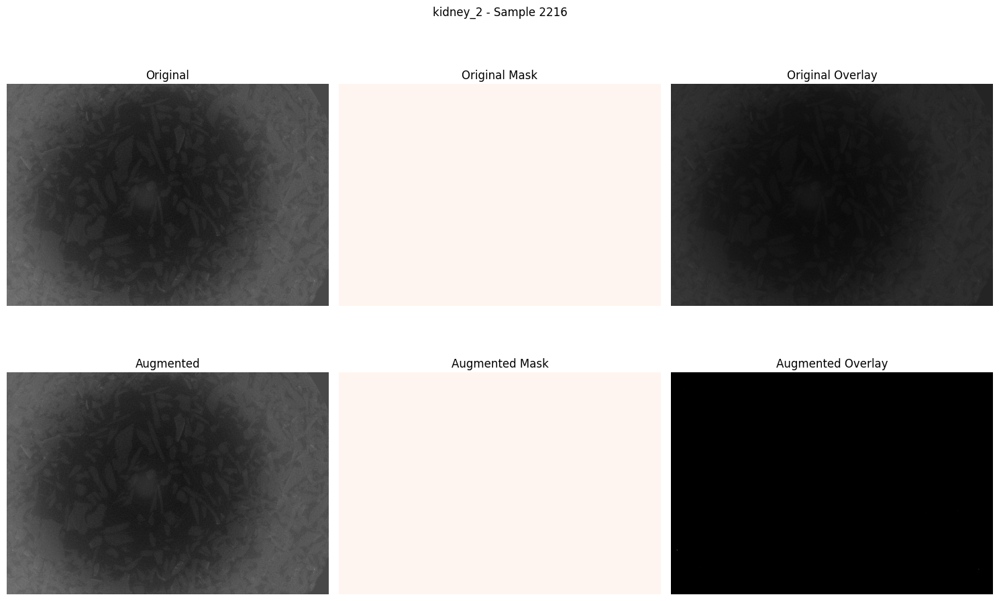

Visualization completed for kidney_2

Processing kidney_3_dense
------------------------------

Processing kidney_3_dense
Required directories not found for kidney_3_dense
Failed to create dataloaders for kidney_3_dense

Processing kidney_3_sparse
------------------------------

Processing kidney_3_sparse
Found 1035 matching pairs
Dataset: Original dimensions: 1706x1510, Target dimensions: 512x512
Dataset: Original dimensions: 1706x1510, Target dimensions: 512x512
Created train dataloader with 828 samples
Created val dataloader with 207 samples

Displaying samples from kidney_3_sparse


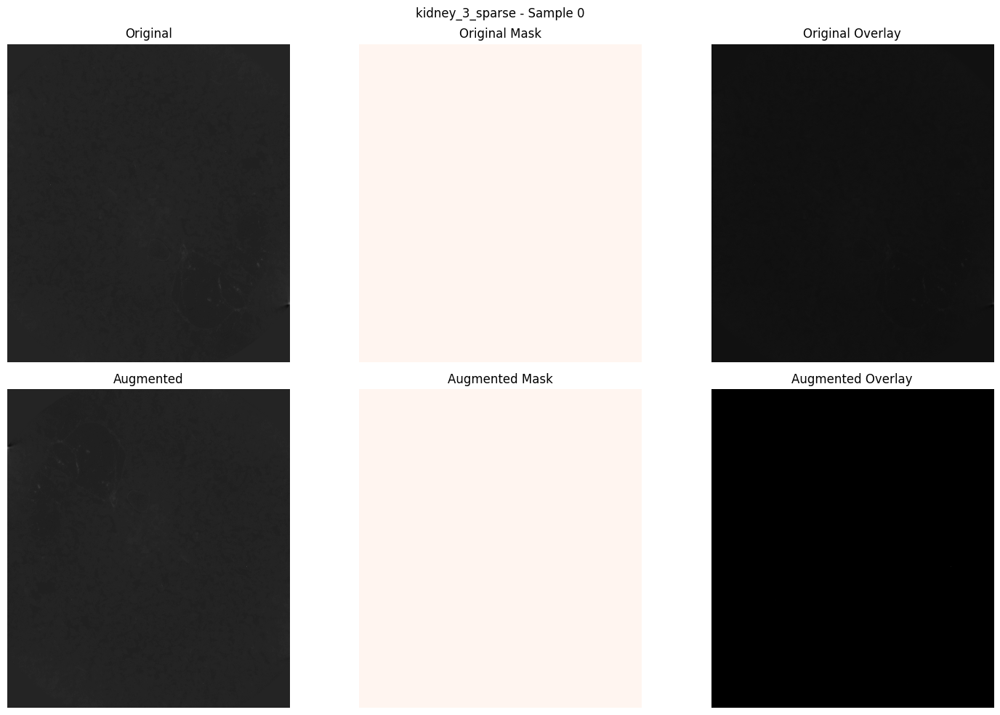

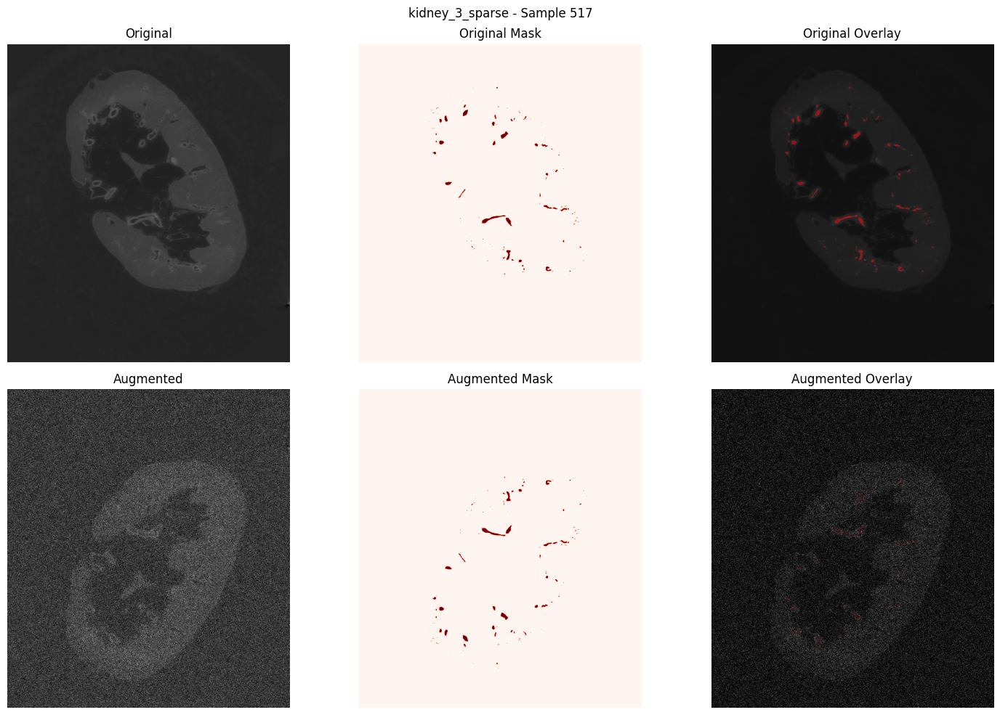

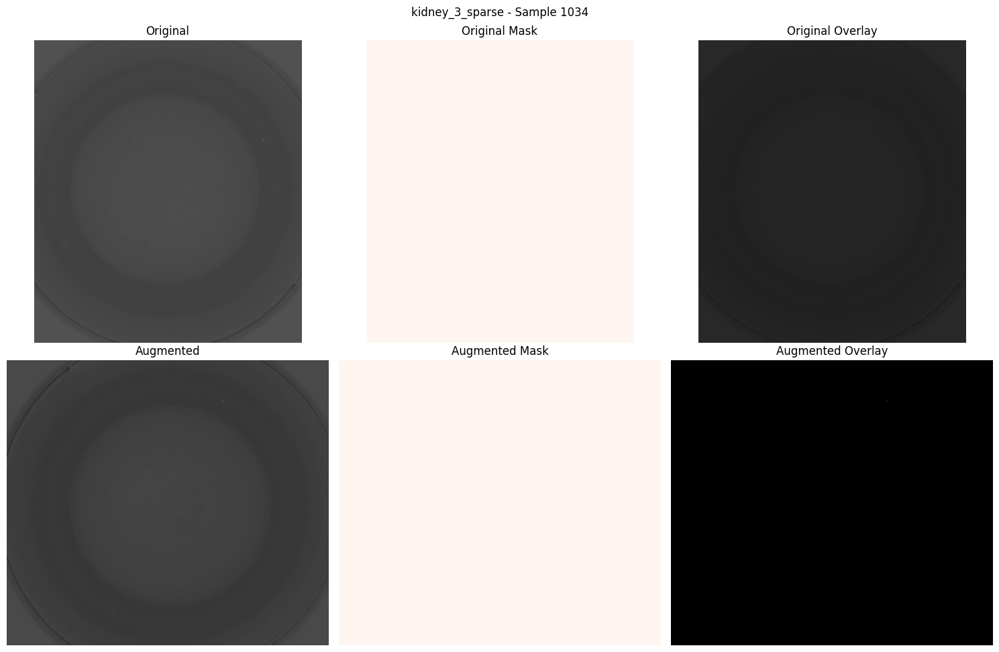

Visualization completed for kidney_3_sparse

Preprocessing Summary:
Successfully processed datasets: 4/5
- kidney_1_dense
- kidney_1_voi
- kidney_2
- kidney_3_sparse

Saving dataloader information...

Dataloader information saved to /kaggle/working/dataloader_info/dataloader_info.json

Verifying saved dataloaders...
Dataset: Original dimensions: 1303x912, Target dimensions: 512x512
Dataset: Original dimensions: 1303x912, Target dimensions: 512x512
Dataset: Original dimensions: 1928x1928, Target dimensions: 512x512
Dataset: Original dimensions: 1928x1928, Target dimensions: 512x512
Dataset: Original dimensions: 1041x1511, Target dimensions: 512x512
Dataset: Original dimensions: 1041x1511, Target dimensions: 512x512
Dataset: Original dimensions: 1706x1510, Target dimensions: 512x512
Dataset: Original dimensions: 1706x1510, Target dimensions: 512x512

Dataloaders recreated successfully!

Verifying recreated dataloaders:

Dataset: kidney_1_dense
Train samples - Original: 1823, Recreated: 1

In [21]:
def main():
    print("Starting Preprocessing Pipeline")
    print("="*50)
    
    # Declare global variables
    global train_loader, val_loader
    train_loader, val_loader = None, None
    
    # Setup paths
    kaggle_path = Path('/kaggle/input/blood-vessel-segmentation')
    save_dir = Path('/kaggle/working/dataloader_info')  
    
    # List of datasets
    datasets = [
        'kidney_1_dense',
        'kidney_1_voi',
        'kidney_2',
        'kidney_3_dense',
        'kidney_3_sparse'
    ]
    
    # Process each dataset
    dataloaders = {}
    processed_datasets = []
    
    for dataset_name in datasets:
        try:
            print(f"\nProcessing {dataset_name}")
            print("-" * 30)
            
            # Process dataset with memory management
            train_loader, val_loader = process_dataset(
                kaggle_path,
                dataset_name
            )
            
            if train_loader and val_loader:
                dataloaders[dataset_name] = {
                    'train': train_loader,
                    'val': val_loader
                }
                processed_datasets.append(dataset_name)
                
                # Clear memory after successful processing
                gc.collect()
                
                # Visualize samples
                print(f"\nDisplaying samples from {dataset_name}")
                images_path = kaggle_path / 'train' / dataset_name / 'images'
                labels_path = kaggle_path / 'train' / dataset_name / 'labels'
                
                if images_path.exists() and labels_path.exists():
                    visualize_processed_dataset(images_path, labels_path, dataset_name)
                    print(f"Visualization completed for {dataset_name}")
                else:
                    print(f"Could not find image/label directories for {dataset_name}")
            else:
                print(f"Failed to create dataloaders for {dataset_name}")
                    
        except Exception as e:
            print(f"Error processing {dataset_name}: {str(e)}")
            gc.collect()
            continue
    
    print("\nPreprocessing Summary:")
    print("=" * 50)
    print(f"Successfully processed datasets: {len(processed_datasets)}/{len(datasets)}")
    for dataset in processed_datasets:
        print(f"- {dataset}")
    
    # Save dataloader information
    print("\nSaving dataloader information...")
    save_dataloader_info(dataloaders, save_dir)
    
    # Load and verify saved dataloaders
    print("\nVerifying saved dataloaders...")
    recreated_loaders = load_and_recreate_dataloaders(save_dir)
    verify_saved_dataloaders(dataloaders, recreated_loaders)
    
    print("\nPreprocessing and dataloader creation completed!")
    return dataloaders

if __name__ == "__main__":
    dataloaders = main()

# Model Architecture

In [22]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.models import resnet34
from torchvision.models import resnet101

In [23]:
class AttentionBlock(nn.Module):
    def __init__(self, in_channels):
        super().__init__()
        self.conv = nn.Conv2d(in_channels, in_channels, kernel_size=1)
        self.activation = nn.Sigmoid()
        
    def forward(self, x):
        # Avoid operations that could collapse spatial dimensions
        attention = self.conv(x)
        attention = self.activation(attention)
        return x * attention


In [24]:
class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.conv1 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        self.conv2 = nn.Sequential(
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        # Add residual connection
        self.identity = nn.Conv2d(in_channels, out_channels, kernel_size=1) if in_channels != out_channels else nn.Identity()
        
    def forward(self, x):
        identity = self.identity(x)
        out = self.conv1(x)
        out = self.conv2(out)
        return F.relu(out + identity)  # Residual connection

In [25]:
class ResNetUNet(nn.Module):
    def __init__(self, n_classes=1):
        super().__init__()
        
        # Load pretrained ResNet34
        resnet = resnet34(pretrained=True)
        
        # Modify first layer to accept single channel
        self.firstconv = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
        
        # Initialize first layer with pretrained weights
        with torch.no_grad():
            self.firstconv.weight[:, 0:1, :, :] = torch.sum(resnet.conv1.weight, dim=1, keepdim=True)
        
        # Encoder (ResNet layers)
        self.encoder1 = nn.Sequential(
            self.firstconv,
            resnet.bn1,
            resnet.relu
        )
        self.pool = resnet.maxpool
        self.encoder2 = resnet.layer1  # 64 channels
        self.encoder3 = resnet.layer2  # 128 channels
        self.encoder4 = resnet.layer3  # 256 channels
        self.encoder5 = resnet.layer4  # 512 channels
        
        # Simple attention at deepest level
        self.attention = AttentionBlock(512)
        
        # Decoder
        self.decoder5 = ConvBlock(512, 512)
        self.decoder4 = ConvBlock(512 + 256, 256)
        self.decoder3 = ConvBlock(256 + 128, 128)
        self.decoder2 = ConvBlock(128 + 64, 64)
        self.decoder1 = ConvBlock(64 + 64, 32)
        
        # Final layers
        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        self.final_conv = nn.Conv2d(32, n_classes, kernel_size=1)
        
        self.dropout = nn.Dropout2d(0.25)
        
        # Initialize weights of decoder
        self._initialize_weights()
    
    def _initialize_weights(self):
        for m in [self.decoder1, self.decoder2, self.decoder3, self.decoder4, self.decoder5, self.final_conv]:
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)
    
    def forward(self, x):
        # Encoder
        e1 = self.encoder1(x)
        e1_pool = self.pool(e1)
        e2 = self.encoder2(e1_pool)
        e3 = self.encoder3(e2)
        e4 = self.encoder4(e3)
        e5 = self.encoder5(e4)
        
        # Apply simple attention only at the deepest level
        e5 = self.attention(e5)
        
        # Apply dropout for regularization
        e5 = self.dropout(e5)
        
        # Decoder with skip connections
        d5 = self.decoder5(e5)
        d4 = self.decoder4(torch.cat([self.upsample(d5), e4], dim=1))
        d3 = self.decoder3(torch.cat([self.upsample(d4), e3], dim=1))
        d2 = self.decoder2(torch.cat([self.upsample(d3), e2], dim=1))
        d1 = self.decoder1(torch.cat([self.upsample(d2), e1], dim=1))
        
        # Final output
        final_out = self.final_conv(self.upsample(d1))
        
        return torch.sigmoid(final_out)

In [26]:
class DiceLoss(nn.Module):
    def __init__(self, smooth=1.0):
        super().__init__()
        self.smooth = smooth
        
    def forward(self, pred, target):
        pred_flat = pred.view(-1)
        target_flat = target.view(-1)
        
        intersection = (pred_flat * target_flat).sum()
        union = pred_flat.sum() + target_flat.sum()
        
        dice = (2. * intersection + self.smooth) / (union + self.smooth)
        return 1 - dice

In [27]:
class WeightedBCELoss(nn.Module):
    def __init__(self, pos_weight=None):
        super().__init__()
        self.pos_weight = pos_weight
        
    def forward(self, pred, target):
        if self.pos_weight is None:
            # Calculate weights based on inverse class frequency
            neg_count = (target == 0).float().sum()
            pos_count = (target == 1).float().sum()
            total = neg_count + pos_count
            self.pos_weight = (neg_count / total) / (pos_count / total)
        
        return F.binary_cross_entropy_with_logits(
            pred, target, 
            pos_weight=self.pos_weight * torch.ones_like(target)
        )


In [28]:
class CombinedLoss(nn.Module):
    def __init__(self, dice_weight=0.5, bce_weight=0.5):
        super().__init__()
        self.dice_weight = dice_weight
        self.bce_weight = bce_weight
        self.dice_loss = DiceLoss()
        self.weighted_bce = WeightedBCELoss()
        
    def forward(self, pred, target):
        dice = self.dice_loss(pred, target)
        weighted_bce = self.weighted_bce(pred, target)
        
        # Focal Loss component
        pt = torch.exp(-weighted_bce)
        focal = (1 - pt) ** 2 * weighted_bce
        
        return (self.dice_weight * dice + 
                self.bce_weight * weighted_bce 
                )

In [29]:
def initialize_model():
    """Initialize model, loss function, and print architecture summary"""
    print("Initializing Model Architecture")
    print("=" * 50)
    
    try:
        # Initialize model
        model = ResNetUNet(n_classes=1)
        
        # Create loss function
        criterion = CombinedLoss(dice_weight=0.7, bce_weight=0.3)
        
        # Move to GPU if available
        device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        print(f"\nUsing device: {device}")
        
        model = model.to(device)
        
        # Print model summary
        print("\nModel Architecture:")
        print("-" * 30)
        
        # Calculate total parameters
        total_params = sum(p.numel() for p in model.parameters())
        trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
        
        print(f"\nTotal Parameters: {total_params:,}")
        print(f"Trainable Parameters: {trainable_params:,}")
        
        # Test forward pass
        print("\nTesting forward pass...")
        model.eval()  # Set to evaluation mode
        test_input = torch.randn(1, 1, 512, 512).to(device)
        with torch.no_grad():
            test_output = model(test_input)
        print(f"Input shape: {test_input.shape}")
        print(f"Output shape: {test_output.shape}")
        
        print("\nModel architecture initialization completed successfully!")
        return model, criterion, device
        
    except Exception as e:
        print(f"Error in model initialization: {str(e)}")
        return None, None, None


In [30]:
def main():
    print("Starting Model Architecture Setup")
    print("=" * 50)
    
    try:
        # Initialize model, criterion, and device
        model, criterion, device = initialize_model()
        
        if model is None:
            print("Model initialization failed!")
            return None, None, None
        
        # Save model architecture (optional)
        try:
            torch.save(model.state_dict(), '/kaggle/working/initial_model.pth')
            print("\nSaved initial model state")
        except Exception as e:
            print(f"Error saving model: {str(e)}")
        
        print("\nModel Architecture Setup Completed!")
        return model, criterion, device
        
    except Exception as e:
        print(f"Error in main: {str(e)}")
        return None, None, None

if __name__ == "__main__":
    model, criterion, device = main()

Starting Model Architecture Setup
Initializing Model Architecture


Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:01<00:00, 82.9MB/s]



Using device: cuda

Model Architecture:
------------------------------

Total Parameters: 29,668,929
Trainable Parameters: 29,668,929

Testing forward pass...
Input shape: torch.Size([1, 1, 512, 512])
Output shape: torch.Size([1, 1, 512, 512])

Model architecture initialization completed successfully!

Saved initial model state

Model Architecture Setup Completed!


# Training Pipeline

In [31]:
import torch
from torch.optim import Adam
import numpy as np
from tqdm import tqdm
import time
import json
from pathlib import Path
import matplotlib.pyplot as plt
from datetime import datetime
from scipy.ndimage import distance_transform_edt, binary_erosion
from copy import deepcopy
import gc
import traceback

In [32]:
class AverageMeter:
    """Computes and stores the average and current value"""
    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

In [33]:
def calculate_surface_dice(pred, target, tolerance=1):
    """Calculate Surface Dice score with memory-efficient operations"""
    from scipy.ndimage import distance_transform_edt, binary_erosion
    import numpy as np
    
    # Ensure inputs are boolean
    pred = pred.astype(bool)
    target = target.astype(bool)
    
    # Get surface points using XOR operation
    pred_eroded = binary_erosion(pred)
    target_eroded = binary_erosion(target)
    
    pred_surface = np.logical_xor(pred, pred_eroded)
    target_surface = np.logical_xor(target, target_eroded)
    
    # Calculate distance maps
    pred_distance = distance_transform_edt(~pred_surface)
    target_distance = distance_transform_edt(~target_surface)
    
    # Get surface points within tolerance
    pred_tolerant = pred_surface & (target_distance <= tolerance)
    target_tolerant = target_surface & (pred_distance <= tolerance)
    
    # Calculate Surface Dice
    surface_dice = (2.0 * pred_tolerant.sum() + 1e-7) / (pred_surface.sum() + target_surface.sum() + 1e-7)
    
    return surface_dice.item()


In [34]:
def calculate_metrics(pred, target):
    """Calculate Dice and Surface Dice metrics"""
    pred = pred.float()
    target = target.float()
    
    # Move tensors to CPU and convert to numpy for Surface Dice
    pred_np = pred.detach().cpu().numpy()
    target_np = target.detach().cpu().numpy()
    
    # Regular Dice
    intersection = (pred * target).sum()
    union = pred.sum() + target.sum()
    dice = (2. * intersection + 1e-7) / (union + 1e-7)
    
    # Surface Dice (calculate for each sample in batch)
    surface_dice_scores = []
    for p, t in zip(pred_np, target_np):
        surface_dice_scores.append(calculate_surface_dice(p.squeeze(), t.squeeze()))
    avg_surface_dice = np.mean(surface_dice_scores)
    
    # Clear memory
    del pred_np, target_np
    gc.collect()
    
    return {
        'dice': dice.item(),
        'surface_dice': avg_surface_dice
    }

In [35]:
def mixup_batch(images, masks, alpha=0.2):
    lam = np.random.beta(alpha, alpha)
    batch_size = images.size(0)
    index = torch.randperm(batch_size)
    
    mixed_images = lam * images + (1 - lam) * images[index]
    mixed_masks = lam * masks + (1 - lam) * masks[index]
    
    return mixed_images, mixed_masks

In [43]:
class Trainer:
    def __init__(self, model, criterion, optimizer, device, save_dir,
                save_every=1, patience=10):
        self.model = model
        self.criterion = criterion
        self.optimizer = optimizer
        self.device = device
        self.save_dir = Path(save_dir)
        self.save_every = save_every
        self.patience = patience
        
        # Initialize best metrics
        self.best_dice = -1
        self.best_surface_dice = -1
        self.patience_counter = 0
        
        # Initialize history
        self.history = {
            'train_loss': [], 'train_dice': [], 'train_surface_dice': [],
            'val_loss': [], 'val_dice': [], 'val_surface_dice': [],
            'lr': []
        }
        
        # Create save directory if it doesn't exist
        self.save_dir.mkdir(parents=True, exist_ok=True)
        
        # Setup scaler for mixed precision
        self.scaler = torch.cuda.amp.GradScaler()
    
    def train_epoch(self, train_loader):
        self.model.train()
        losses = AverageMeter()
        dice_scores = AverageMeter()
        surface_dice_scores = AverageMeter()
        
        pbar = tqdm(train_loader, desc=f'Training')
        
        for batch_idx, (images, masks) in enumerate(pbar):
            try:
                # Move to device
                images = images.to(self.device)
                masks = masks.to(self.device)
                
                # Forward pass with mixed precision
                self.optimizer.zero_grad()
                
                with torch.cuda.amp.autocast():
                    outputs = self.model(images)
                    loss = self.criterion(outputs, masks)
                
                # Backward pass with gradient scaling
                self.scaler.scale(loss).backward()
                self.scaler.step(self.optimizer)
                self.scaler.update()
                
                # Calculate metrics
                with torch.no_grad():
                    metrics = calculate_metrics((outputs > 0.5).float(), masks)
                
                # Update meters
                losses.update(loss.item(), images.size(0))
                dice_scores.update(metrics['dice'], images.size(0))
                surface_dice_scores.update(metrics['surface_dice'], images.size(0))
                
                # Update progress bar
                pbar.set_postfix({
                    'Loss': f'{losses.avg:.4f}',
                    'Dice': f'{dice_scores.avg:.4f}',
                    'SurfDice': f'{surface_dice_scores.avg:.4f}',
                    'LR': f"{self.optimizer.param_groups[0]['lr']:.6f}"
                })
                
                # Clear memory
                del images, masks, outputs, loss
                if batch_idx % 10 == 0:
                    gc.collect()
                    if torch.cuda.is_available():
                        torch.cuda.empty_cache()
            
            except Exception as e:
                print(f"Error in training batch: {str(e)}")
                continue
        
        return {
            'loss': losses.avg,
            'dice': dice_scores.avg,
            'surface_dice': surface_dice_scores.avg
        }
    
    def validate(self, val_loader):
        self.model.eval()
        
        losses = AverageMeter()
        dice_scores = AverageMeter()
        surface_dice_scores = AverageMeter()
        
        with torch.no_grad():
            pbar = tqdm(val_loader, desc='Validating')
            for images, masks in pbar:
                try:
                    # Move to device
                    images = images.to(self.device)
                    masks = masks.to(self.device)
                    
                    # Forward pass
                    outputs = self.model(images)
                    loss = self.criterion(outputs, masks)
                    
                    # Calculate metrics
                    pred_binary = (outputs > 0.5).float()
                    metrics = calculate_metrics(pred_binary, masks)
                    
                    # Update meters
                    losses.update(loss.item(), images.size(0))
                    dice_scores.update(metrics['dice'], images.size(0))
                    surface_dice_scores.update(metrics['surface_dice'], images.size(0))
                    
                    # Update progress bar
                    pbar.set_postfix({
                        'Loss': f'{losses.avg:.4f}',
                        'Dice': f'{dice_scores.avg:.4f}',
                        'SurfDice': f'{surface_dice_scores.avg:.4f}'
                    })
                    
                    # Clear memory
                    del images, masks, outputs, pred_binary
                    gc.collect()
                    if torch.cuda.is_available():
                        torch.cuda.empty_cache()
                
                except Exception as e:
                    print(f"Error in validation batch: {str(e)}")
                    continue
        
        return {
            'loss': losses.avg,
            'dice': dice_scores.avg,
            'surface_dice': surface_dice_scores.avg
        }
    
    def train(self, train_loader, val_loader, num_epochs, scheduler=None, early_stopping=True):
        """Train the model with safer approach"""
        print(f"Starting safer improved training with {num_epochs} epochs")
        
        for epoch in range(1, num_epochs + 1):
            print(f'\nEpoch {epoch}/{num_epochs}')
            print('-' * 20)
            
            # Train
            train_metrics = self.train_epoch(train_loader)
            
            # Validate
            val_metrics = self.validate(val_loader)
            
            # Update scheduler with validation metrics for ReduceLROnPlateau
            if scheduler is not None and isinstance(scheduler, torch.optim.lr_scheduler.ReduceLROnPlateau):
                # Use dice score as the metric to monitor
                scheduler.step(val_metrics['dice'])
            elif scheduler is not None:
                # For other schedulers that don't need metrics
                scheduler.step()
            
            # Update history
            self.history['train_loss'].append(train_metrics['loss'])
            self.history['train_dice'].append(train_metrics['dice'])
            self.history['train_surface_dice'].append(train_metrics['surface_dice'])
            self.history['val_loss'].append(val_metrics['loss'])
            self.history['val_dice'].append(val_metrics['dice'])
            self.history['val_surface_dice'].append(val_metrics['surface_dice'])
            self.history['lr'].append(self.optimizer.param_groups[0]['lr'])
            
            # Print epoch summary
            print(f"\nEpoch {epoch} Summary:")
            print(f"Train - Loss: {train_metrics['loss']:.4f}, "
                 f"Dice: {train_metrics['dice']:.4f}, "
                 f"Surface Dice: {train_metrics['surface_dice']:.4f}")
            print(f"Val - Loss: {val_metrics['loss']:.4f}, "
                 f"Dice: {val_metrics['dice']:.4f}, "
                 f"Surface Dice: {val_metrics['surface_dice']:.4f}")
            
            # Check for improvement
            improved = False
            if val_metrics['dice'] > self.best_dice:
                self.best_dice = val_metrics['dice']
                improved = True
                print(f"New best Dice: {self.best_dice:.4f}")
            
            if val_metrics['surface_dice'] > self.best_surface_dice:
                self.best_surface_dice = val_metrics['surface_dice']
                improved = True
                print(f"New best Surface Dice: {self.best_surface_dice:.4f}")
            
            # Save checkpoint if improved
            if improved:
                self.patience_counter = 0
                self.save_checkpoint(epoch, val_metrics, is_best=True)
                print("New best model saved!")
            else:
                self.patience_counter += 1
                print(f"No improvement for {self.patience_counter} epochs")
                if early_stopping and self.patience_counter >= self.patience:
                    print(f"\nEarly stopping triggered after {self.patience} epochs without improvement")
                    break
            
            # Plot current progress
            if epoch % 2 == 0 or epoch == num_epochs:
                self.plot_training_history()
            
            # Clear memory
            gc.collect()
            if torch.cuda.is_available():
                torch.cuda.empty_cache()
        
        print("\nTraining completed!")
        print(f"Best Dice Score: {self.best_dice:.4f}")
        print(f"Best Surface Dice Score: {self.best_surface_dice:.4f}")
        
        return self.best_dice, self.best_surface_dice
           
    
    def save_checkpoint(self, epoch, metrics, is_best=False):
        """Save training checkpoint"""
        checkpoint = {
            'epoch': epoch,
            'model_state_dict': self.model.state_dict(),
            'optimizer_state_dict': self.optimizer.state_dict(),
            'metrics': metrics,
            'best_dice': self.best_dice,
            'best_surface_dice': self.best_surface_dice,
            'history': self.history
        }
        
        # Save periodic checkpoint
        if epoch % self.save_every == 0:
            checkpoint_path = self.save_dir / f'checkpoint_epoch_{epoch}.pth'
            torch.save(checkpoint, checkpoint_path)
            print(f"Saved checkpoint to {checkpoint_path}")
        
        # Save best model
        if is_best:
            best_model_path = self.save_dir / 'best_model.pth'
            torch.save(checkpoint, best_model_path)
            print(f"Saved best model to {best_model_path}")
        
        # Clear memory
        del checkpoint
        gc.collect()
        if torch.cuda.is_available():
            torch.cuda.empty_cache()
    

    def load_checkpoint(self, checkpoint_path):
        """Load training checkpoint"""
        try:
            checkpoint = torch.load(checkpoint_path, map_location=self.device)
            self.model.load_state_dict(checkpoint['model_state_dict'])
            self.optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
            self.best_dice = checkpoint['best_dice']
            self.best_surface_dice = checkpoint['best_surface_dice']
            self.history = checkpoint['history']
            start_epoch = checkpoint['epoch']
            
            print(f"Loaded checkpoint from epoch {start_epoch}")
            return start_epoch
        
        except Exception as e:
            print(f"Error loading checkpoint: {str(e)}")
            return 0
    
    def save_history(self):
        """Save training history to JSON"""
        history_path = self.save_dir / 'training_history.json'
        with open(history_path, 'w') as f:
            json.dump(self.history, f)
        print(f"Saved training history to {history_path}")
        
    def plot_training_history(self):
        """Display training history plots without saving"""
        if len(self.history['train_loss']) < 2:
            print("Not enough data points to plot (need at least 2 epochs)")
            return
        
        plt.figure(figsize=(15, 10))
        
        # Plot loss
        plt.subplot(2, 1, 1)
        plt.plot(self.history['train_loss'], 'b-', label='Train', marker='o')
        plt.plot(self.history['val_loss'], 'r-', label='Validation', marker='s')
        plt.title('Loss History')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.grid(True)
        plt.legend()
        
        # Plot metrics
        plt.subplot(2, 1, 2)
        plt.plot(self.history['train_dice'], 'b-', label='Train Dice', marker='o')
        plt.plot(self.history['val_dice'], 'b--', label='Val Dice', marker='s')
        plt.plot(self.history['train_surface_dice'], 'r-', label='Train Surface Dice', marker='^')
        plt.plot(self.history['val_surface_dice'], 'r--', label='Val Surface Dice', marker='v')
        plt.title('Metrics History')
        plt.xlabel('Epoch')
        plt.ylabel('Score')
        plt.grid(True)
        plt.legend()
        
        plt.tight_layout()
        plt.show()
        plt.close()
        
        # Clear memory
        gc.collect()
        if torch.cuda.is_available():
            torch.cuda.empty_cache()

In [44]:
def load_and_recreate_dataloaders(save_dir):
    """Recreate dataloaders from saved information"""
    save_dir = Path(save_dir)
    
    # Load saved information
    with open(save_dir / 'dataloader_info.json', 'r') as f:
        dataset_info = json.load(f)
    
    dataloaders = {}
    
    for dataset_name, info in dataset_info.items():
        # Create train dataset
        train_dataset = VesselDataset(
            image_files=[Path(p) for p in info['train']['image_files']],
            label_files=[Path(p) for p in info['train']['label_files']],
            transform=get_train_transforms(dataset_name)
        )
        
        # Create val dataset
        val_dataset = VesselDataset(
            image_files=[Path(p) for p in info['val']['image_files']],
            label_files=[Path(p) for p in info['val']['label_files']],
            transform=get_val_transforms()
        )
        
        # Create dataloaders
        config = info['config']
        train_loader = DataLoader(
            train_dataset,
            batch_size=config['batch_size'],
            shuffle=True,
            num_workers=config['num_workers'],
            pin_memory=config['pin_memory']
        )
        
        val_loader = DataLoader(
            val_dataset,
            batch_size=config['batch_size'],
            shuffle=False,
            num_workers=config['num_workers'],
            pin_memory=config['pin_memory']
        )
        
        dataloaders[dataset_name] = {
            'train': train_loader,
            'val': val_loader
        }
    
    return dataloaders


In [45]:
def create_subset_loader(loader, subset_size=50):
    """Create a smaller dataloader for testing"""
    subset_dataset = torch.utils.data.Subset(
        loader.dataset, 
        indices=range(min(subset_size, len(loader.dataset)))
    )
    return DataLoader(
        subset_dataset,
        batch_size=loader.batch_size,
        shuffle=True,
        num_workers=loader.num_workers,
        pin_memory=loader.pin_memory
    )

Starting Safer Improved Training Pipeline

Loading dataloaders...
Dataset: Original dimensions: 1303x912, Target dimensions: 512x512
Dataset: Original dimensions: 1303x912, Target dimensions: 512x512
Dataset: Original dimensions: 1928x1928, Target dimensions: 512x512
Dataset: Original dimensions: 1928x1928, Target dimensions: 512x512
Dataset: Original dimensions: 1041x1511, Target dimensions: 512x512
Dataset: Original dimensions: 1041x1511, Target dimensions: 512x512
Dataset: Original dimensions: 1706x1510, Target dimensions: 512x512
Dataset: Original dimensions: 1706x1510, Target dimensions: 512x512
Successfully loaded dataloaders for 4 datasets

Loading model with minimal improvements...

Using device: cuda

Created base save directory: /kaggle/working/safer_improved_training_results_20250227_013459

Training Configuration:
Mode: Safer Improved
Number of epochs: 2
Device: cuda

Training on dataset: kidney_1_dense
Train samples: 1823
Val samples: 456
------------------------------
Sav

Validating: 100%|██████████| 114/114 [03:12<00:00,  1.69s/it, Loss=0.5118, Dice=0.7574, SurfDice=0.6697]



Epoch 1 Summary:
Train - Loss: 0.6023, Dice: 0.6522, Surface Dice: 0.5331
Val - Loss: 0.5118, Dice: 0.7574, Surface Dice: 0.6697
New best Dice: 0.7574
New best Surface Dice: 0.6697
Saved best model to /kaggle/working/safer_improved_training_results_20250227_013459/kidney_1_dense/best_model.pth
New best model saved!

Epoch 2/2
--------------------


Validating: 100%|██████████| 114/114 [02:44<00:00,  1.44s/it, Loss=0.4789, Dice=0.7950, SurfDice=0.7427]



Epoch 2 Summary:
Train - Loss: 0.5037, Dice: 0.7744, Surface Dice: 0.6925
Val - Loss: 0.4789, Dice: 0.7950, Surface Dice: 0.7427
New best Dice: 0.7950
New best Surface Dice: 0.7427
Saved best model to /kaggle/working/safer_improved_training_results_20250227_013459/kidney_1_dense/best_model.pth
New best model saved!


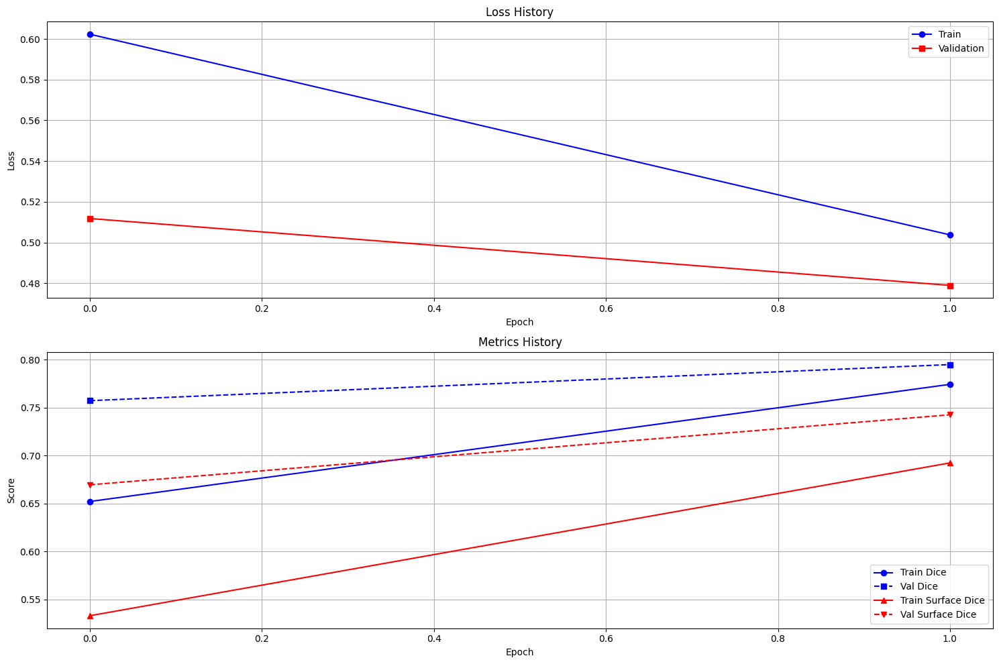


Training completed!
Best Dice Score: 0.7950
Best Surface Dice Score: 0.7427

Completed training for kidney_1_dense
Best Dice Score: 0.7950
Best Surface Dice Score: 0.7427
Saved training history to /kaggle/working/safer_improved_training_results_20250227_013459/kidney_1_dense/training_history.json

Training on dataset: kidney_1_voi
Train samples: 1117
Val samples: 280
------------------------------
Save directory for kidney_1_voi: /kaggle/working/safer_improved_training_results_20250227_013459/kidney_1_voi
Starting safer improved training with 2 epochs

Epoch 1/2
--------------------


Validating: 100%|██████████| 70/70 [02:17<00:00,  1.96s/it, Loss=0.4692, Dice=0.9253, SurfDice=0.8709]



Epoch 1 Summary:
Train - Loss: 0.4918, Dice: 0.8939, Surface Dice: 0.8068
Val - Loss: 0.4692, Dice: 0.9253, Surface Dice: 0.8709
New best Dice: 0.9253
New best Surface Dice: 0.8709
Saved best model to /kaggle/working/safer_improved_training_results_20250227_013459/kidney_1_voi/best_model.pth
New best model saved!

Epoch 2/2
--------------------


Validating: 100%|██████████| 70/70 [01:44<00:00,  1.50s/it, Loss=0.4536, Dice=0.9398, SurfDice=0.9076]



Epoch 2 Summary:
Train - Loss: 0.4688, Dice: 0.9251, Surface Dice: 0.8783
Val - Loss: 0.4536, Dice: 0.9398, Surface Dice: 0.9076
New best Dice: 0.9398
New best Surface Dice: 0.9076
Saved best model to /kaggle/working/safer_improved_training_results_20250227_013459/kidney_1_voi/best_model.pth
New best model saved!


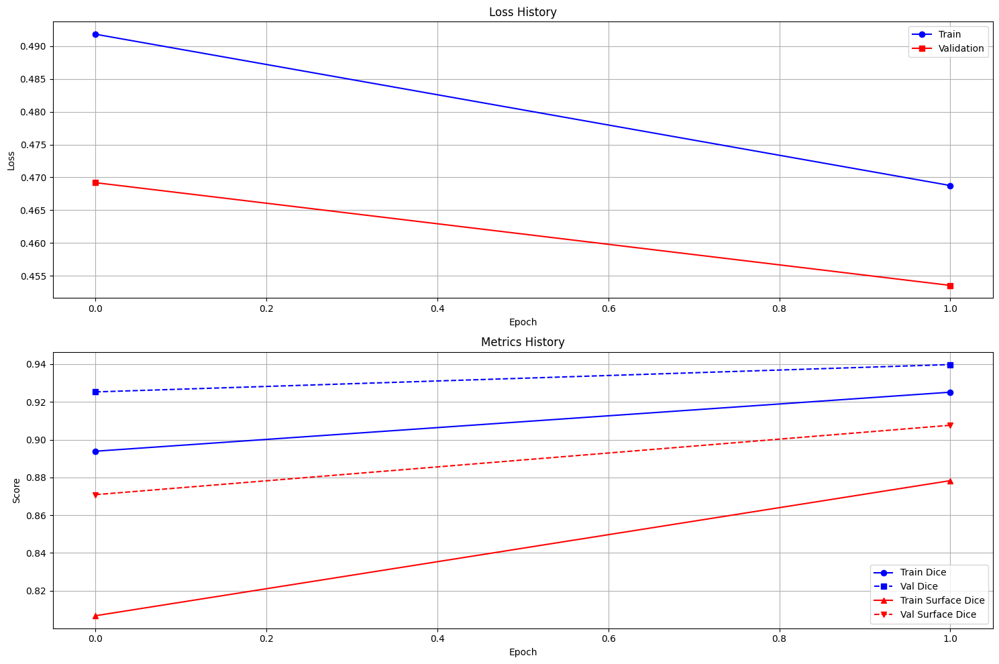


Training completed!
Best Dice Score: 0.9398
Best Surface Dice Score: 0.9076

Completed training for kidney_1_voi
Best Dice Score: 0.9398
Best Surface Dice Score: 0.9076
Saved training history to /kaggle/working/safer_improved_training_results_20250227_013459/kidney_1_voi/training_history.json

Training on dataset: kidney_2
Train samples: 1773
Val samples: 444
------------------------------
Save directory for kidney_2: /kaggle/working/safer_improved_training_results_20250227_013459/kidney_2
Starting safer improved training with 2 epochs

Epoch 1/2
--------------------


Validating: 100%|██████████| 111/111 [03:10<00:00,  1.71s/it, Loss=0.6184, Dice=0.8230, SurfDice=0.8169]



Epoch 1 Summary:
Train - Loss: 0.6699, Dice: 0.8144, Surface Dice: 0.7260
Val - Loss: 0.6184, Dice: 0.8230, Surface Dice: 0.8169
New best Dice: 0.8230
New best Surface Dice: 0.8169
Saved best model to /kaggle/working/safer_improved_training_results_20250227_013459/kidney_2/best_model.pth
New best model saved!

Epoch 2/2
--------------------


Validating: 100%|██████████| 111/111 [02:40<00:00,  1.44s/it, Loss=0.6010, Dice=0.8565, SurfDice=0.7992]



Epoch 2 Summary:
Train - Loss: 0.6306, Dice: 0.8505, Surface Dice: 0.8068
Val - Loss: 0.6010, Dice: 0.8565, Surface Dice: 0.7992
New best Dice: 0.8565
Saved best model to /kaggle/working/safer_improved_training_results_20250227_013459/kidney_2/best_model.pth
New best model saved!


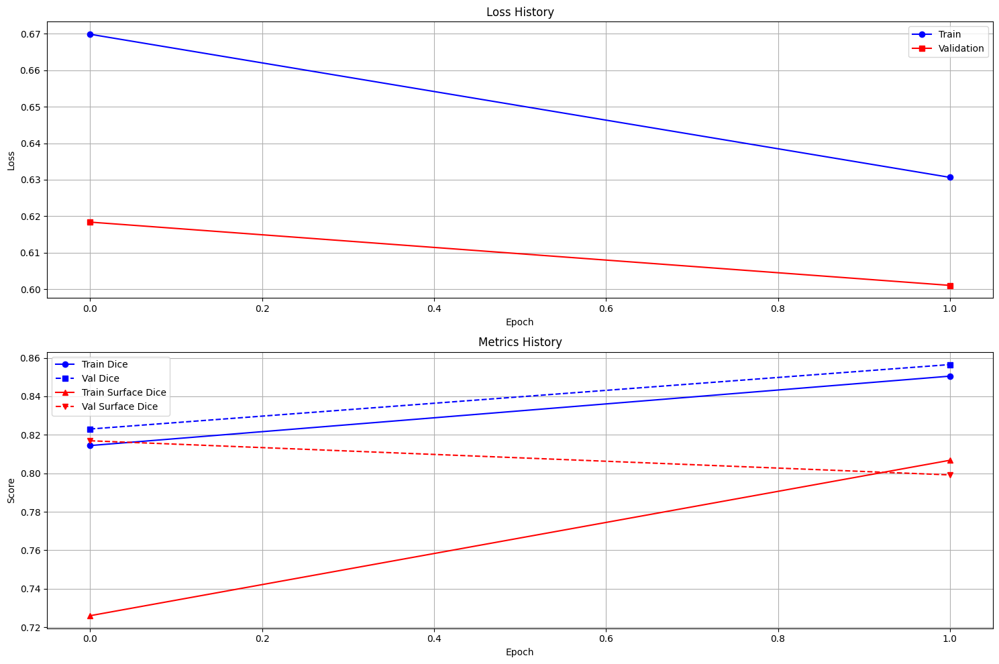


Training completed!
Best Dice Score: 0.8565
Best Surface Dice Score: 0.8169

Completed training for kidney_2
Best Dice Score: 0.8565
Best Surface Dice Score: 0.8169
Saved training history to /kaggle/working/safer_improved_training_results_20250227_013459/kidney_2/training_history.json

Training on dataset: kidney_3_sparse
Train samples: 828
Val samples: 207
------------------------------
Save directory for kidney_3_sparse: /kaggle/working/safer_improved_training_results_20250227_013459/kidney_3_sparse
Starting safer improved training with 2 epochs

Epoch 1/2
--------------------


Validating: 100%|██████████| 52/52 [01:35<00:00,  1.84s/it, Loss=0.4500, Dice=0.7087, SurfDice=0.7170]



Epoch 1 Summary:
Train - Loss: 0.6100, Dice: 0.5297, Surface Dice: 0.4660
Val - Loss: 0.4500, Dice: 0.7087, Surface Dice: 0.7170
New best Dice: 0.7087
New best Surface Dice: 0.7170
Saved best model to /kaggle/working/safer_improved_training_results_20250227_013459/kidney_3_sparse/best_model.pth
New best model saved!

Epoch 2/2
--------------------


Validating: 100%|██████████| 52/52 [01:15<00:00,  1.46s/it, Loss=0.4173, Dice=0.7463, SurfDice=0.7647]



Epoch 2 Summary:
Train - Loss: 0.6076, Dice: 0.5336, Surface Dice: 0.4811
Val - Loss: 0.4173, Dice: 0.7463, Surface Dice: 0.7647
New best Dice: 0.7463
New best Surface Dice: 0.7647
Saved best model to /kaggle/working/safer_improved_training_results_20250227_013459/kidney_3_sparse/best_model.pth
New best model saved!


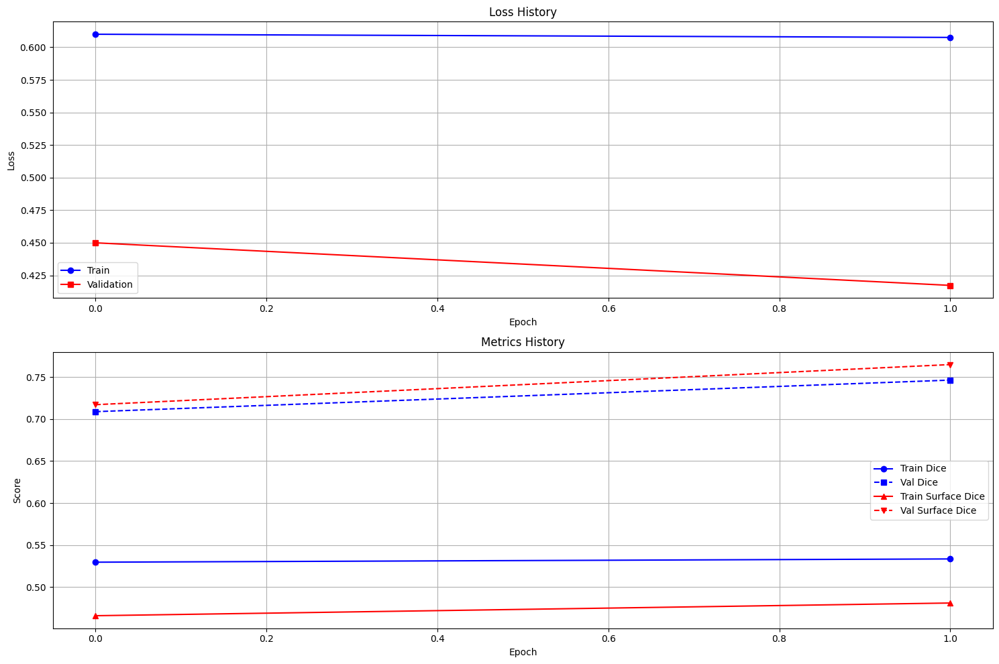


Training completed!
Best Dice Score: 0.7463
Best Surface Dice Score: 0.7647

Completed training for kidney_3_sparse
Best Dice Score: 0.7463
Best Surface Dice Score: 0.7647
Saved training history to /kaggle/working/safer_improved_training_results_20250227_013459/kidney_3_sparse/training_history.json

Training Pipeline Completed!

Final Results Summary:

kidney_1_dense:
Best Dice Score: 0.7950
Best Surface Dice Score: 0.7427

kidney_1_voi:
Best Dice Score: 0.9398
Best Surface Dice Score: 0.9076

kidney_2:
Best Dice Score: 0.8565
Best Surface Dice Score: 0.8169

kidney_3_sparse:
Best Dice Score: 0.7463
Best Surface Dice Score: 0.7647

Saved final results to: /kaggle/working/safer_improved_training_results_20250227_013459/final_results.json


In [46]:
def main(test_mode=False, subset_size=50, num_epochs=15):
    """
    Safer improved training pipeline with minimal changes to your original model
    
    Args:
        test_mode (bool): If True, use subset of data for testing
        subset_size (int): Number of samples to use in test mode
        num_epochs (int): Number of epochs to train
    """
    print("Starting Safer Improved Training Pipeline")
    print("=" * 50)
    
    try:
        # Clear initial memory
        gc.collect()
        if torch.cuda.is_available():
            torch.cuda.empty_cache()
        
        # Load dataloaders
        print("\nLoading dataloaders...")
        dataloader_path = Path('/kaggle/working/dataloader_info')
        dataloaders = load_and_recreate_dataloaders(dataloader_path)
        print(f"Successfully loaded dataloaders for {len(dataloaders)} datasets")
        
        if test_mode:
            print(f"\nTest Mode: Creating subset of {subset_size} samples")
            subset_loaders = {}
            for dataset_name, loaders in dataloaders.items():
                subset_loaders[dataset_name] = {
                    'train': create_subset_loader(loaders['train'], subset_size),
                    'val': create_subset_loader(loaders['val'], subset_size//5)
                }
            dataloaders = subset_loaders
            print("Created subset dataloaders for testing")
            gc.collect()
        
        # Load improved model
        print("\nLoading model with minimal improvements...")
        model = ResNetUNet(n_classes=1)
        
        # Setup device
        device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        print(f"\nUsing device: {device}")
        model = model.to(device)
        
        # Setup save directory
        timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
        mode_prefix = 'test' if test_mode else 'safer_improved'
        base_save_dir = Path(f'/kaggle/working/{mode_prefix}_training_results_{timestamp}')
        base_save_dir.mkdir(parents=True, exist_ok=True)
        print(f"\nCreated base save directory: {base_save_dir}")
        
        # Print training configuration
        print("\nTraining Configuration:")
        print(f"Mode: {'Test' if test_mode else 'Safer Improved'}")
        print(f"Number of epochs: {num_epochs}")
        print(f"Device: {device}")
        if test_mode:
            print(f"Subset size: {subset_size}")
        
        # Initialize results dictionary to store best scores
        results = {}
        
        # Start training for each dataset
        for dataset_name, loaders in dataloaders.items():
            print(f"\nTraining on dataset: {dataset_name}")
            print(f"Train samples: {len(loaders['train'].dataset)}")
            print(f"Val samples: {len(loaders['val'].dataset)}")
            print("-" * 30)
            
            # Get dataset-specific weights
            weights = class_weights.get(dataset_name, {'dice_weight': 0.7, 'bce_weight': 0.3})
            
            criterion = CombinedLoss(
                dice_weight=weights['dice_weight'], 
                bce_weight=weights['bce_weight']
            )
            
            # Setup optimizer - keeping original learning rate
            optimizer = torch.optim.Adam(
                model.parameters(), 
                lr=1e-4,
                weight_decay=1e-5
            )
            
            # Setup learning rate scheduler - simple ReduceLROnPlateau
            scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
                optimizer,
                mode='max',  
                factor=0.5,  
                patience=3,  
                verbose=True,
                min_lr=1e-6
            )
            
            # Create dataset-specific save directory
            dataset_save_dir = base_save_dir / dataset_name
            dataset_save_dir.mkdir(parents=True, exist_ok=True)
            print(f"Save directory for {dataset_name}: {dataset_save_dir}")
            
            # Create trainer
            trainer = Trainer(
                model=model,
                criterion=criterion,
                optimizer=optimizer,
                device=device,
                save_dir=dataset_save_dir,
                save_every=1 if test_mode else 3,
                patience=3 if test_mode else 8
            )
            
            # Train
            best_dice, best_surface_dice = trainer.train(
                train_loader=loaders['train'],
                val_loader=loaders['val'],
                num_epochs=num_epochs,
                scheduler=scheduler,
                early_stopping=True
            )
            
            # Store results
            results[dataset_name] = {
                'best_dice': best_dice,
                'best_surface_dice': best_surface_dice
            }
            
            print(f"\nCompleted training for {dataset_name}")
            print(f"Best Dice Score: {best_dice:.4f}")
            print(f"Best Surface Dice Score: {best_surface_dice:.4f}")
            
            # Save history
            trainer.save_history()
            
            # Clear memory
            gc.collect()
            if torch.cuda.is_available():
                torch.cuda.empty_cache()
            
            # Clear some variables to free memory
            del loaders, trainer
            gc.collect()
        
        print("\nTraining Pipeline Completed!")
        print("\nFinal Results Summary:")
        print("=" * 50)
        for dataset_name, metrics in results.items():
            print(f"\n{dataset_name}:")
            print(f"Best Dice Score: {metrics['best_dice']:.4f}")
            print(f"Best Surface Dice Score: {metrics['best_surface_dice']:.4f}")
        
        # Save final results
        results_path = base_save_dir / 'final_results.json'
        with open(results_path, 'w') as f:
            json.dump(results, f, indent=4)
        print(f"\nSaved final results to: {results_path}")
        
        # Final memory cleanup
        gc.collect()
        if torch.cuda.is_available():
            torch.cuda.empty_cache()
        
        return results
    
    except Exception as e:
        print(f"Error in training pipeline: {str(e)}")
        import traceback
        traceback.print_exc()
        gc.collect()
        if torch.cuda.is_available():
            torch.cuda.empty_cache()
        return None


if __name__ == "__main__":
    # For testing
    #results = safer_improved_main(test_mode=True, num_epochs=2, subset_size=50)
    
    # For full training (uncomment to use)
    results = main(test_mode=False, num_epochs=2)

# Visualization

In [47]:
import torch
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
import random
import gc

In [48]:
def visualize_predictions(model, dataset_name, val_loader, device, num_samples=3):
    """
    Visualize model predictions for a given dataset
    """
    model.eval()
    
    # Get random batch
    try:
        dataiter = iter(val_loader)
        images, masks = next(dataiter)
        
        # Select random indices
        batch_size = images.size(0)
        indices = random.sample(range(batch_size), min(num_samples, batch_size))
        
        # Create figure
        fig, axes = plt.subplots(num_samples, 3, figsize=(15, 5*num_samples))
        fig.suptitle(f'Model Predictions for {dataset_name}', fontsize=16)
        
        with torch.no_grad():
            # Move to device
            images = images.to(device)
            masks = masks.to(device)
            
            # Get predictions
            outputs = model(images)
            predictions = (outputs > 0.5).float()
            
            # Display images
            for idx, sample_idx in enumerate(indices):
                # Get single sample
                image = images[sample_idx].cpu().squeeze().numpy()
                mask = masks[sample_idx].cpu().squeeze().numpy()
                pred = predictions[sample_idx].cpu().squeeze().numpy()
                
                # Original image
                axes[idx, 0].imshow(image, cmap='gray')
                axes[idx, 0].set_title('Original Image')
                axes[idx, 0].axis('off')
                
                # Ground truth mask
                axes[idx, 1].imshow(mask, cmap='Reds')  
                axes[idx, 1].set_title('Ground Truth')
                axes[idx, 1].axis('off')
                
                # Prediction
                axes[idx, 2].imshow(pred, cmap='Reds')  
                axes[idx, 2].set_title('Prediction')
                axes[idx, 2].axis('off')
        
        plt.tight_layout()
        plt.show()
        plt.close()
        
        # Clear memory
        del images, masks, outputs, predictions
        gc.collect()
        if torch.cuda.is_available():
            torch.cuda.empty_cache()
            
    except Exception as e:
        print(f"Error visualizing predictions for {dataset_name}: {str(e)}")

Starting visualization...

Loading dataloaders...
Dataset: Original dimensions: 1303x912, Target dimensions: 512x512
Dataset: Original dimensions: 1303x912, Target dimensions: 512x512
Dataset: Original dimensions: 1928x1928, Target dimensions: 512x512
Dataset: Original dimensions: 1928x1928, Target dimensions: 512x512
Dataset: Original dimensions: 1041x1511, Target dimensions: 512x512
Dataset: Original dimensions: 1041x1511, Target dimensions: 512x512
Dataset: Original dimensions: 1706x1510, Target dimensions: 512x512
Dataset: Original dimensions: 1706x1510, Target dimensions: 512x512

Initializing model...

Using results from: /kaggle/working/safer_improved_training_results_20250227_013459

Visualizing predictions for kidney_1_dense
Looking for model at: /kaggle/working/safer_improved_training_results_20250227_013459/kidney_1_dense/best_model.pth
Loaded model with Best Dice: 0.7950


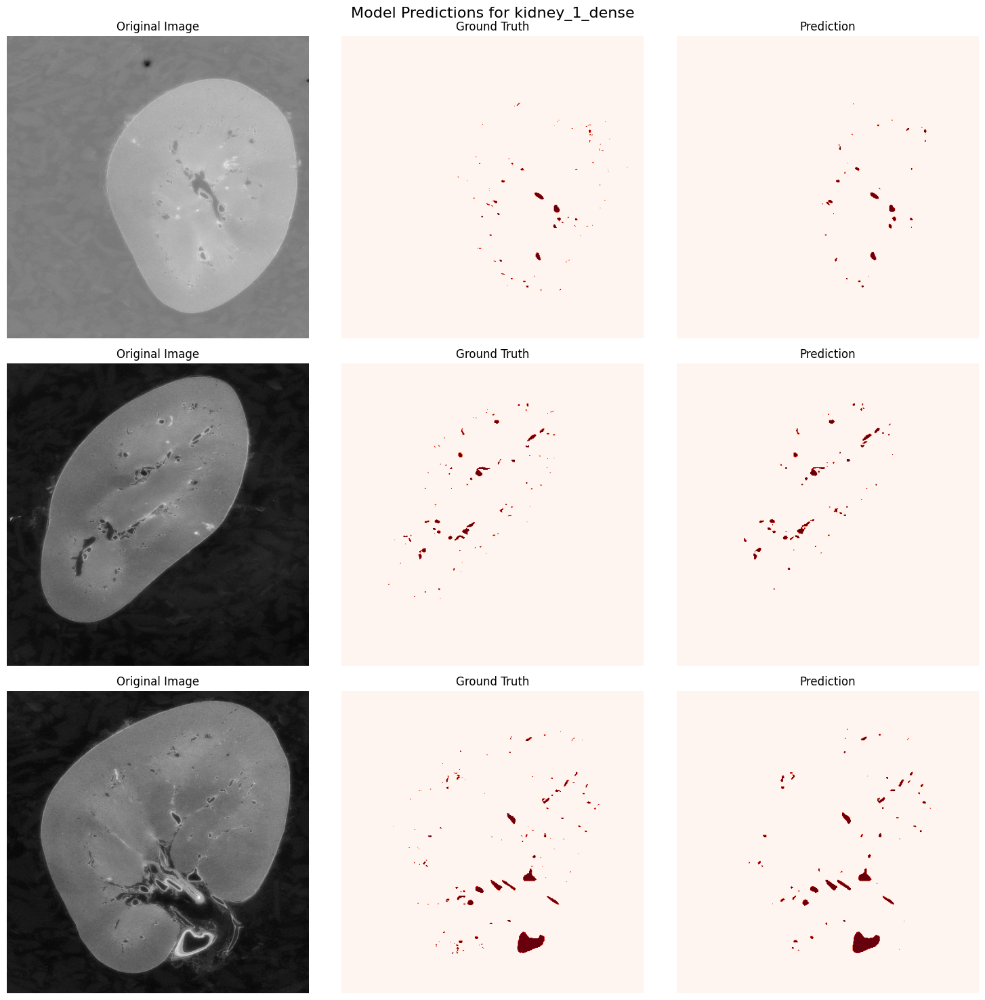


Visualizing predictions for kidney_1_voi
Looking for model at: /kaggle/working/safer_improved_training_results_20250227_013459/kidney_1_voi/best_model.pth
Loaded model with Best Dice: 0.9398


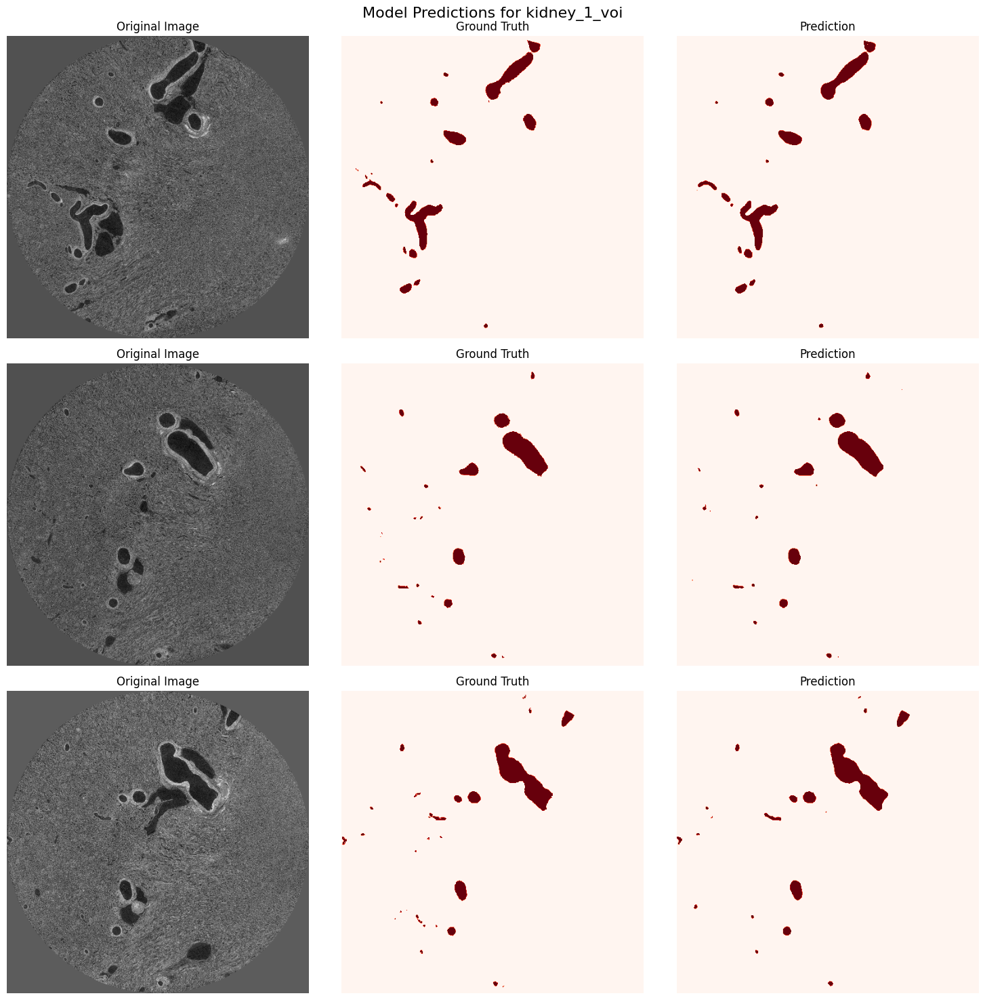


Visualizing predictions for kidney_2
Looking for model at: /kaggle/working/safer_improved_training_results_20250227_013459/kidney_2/best_model.pth
Loaded model with Best Dice: 0.8565


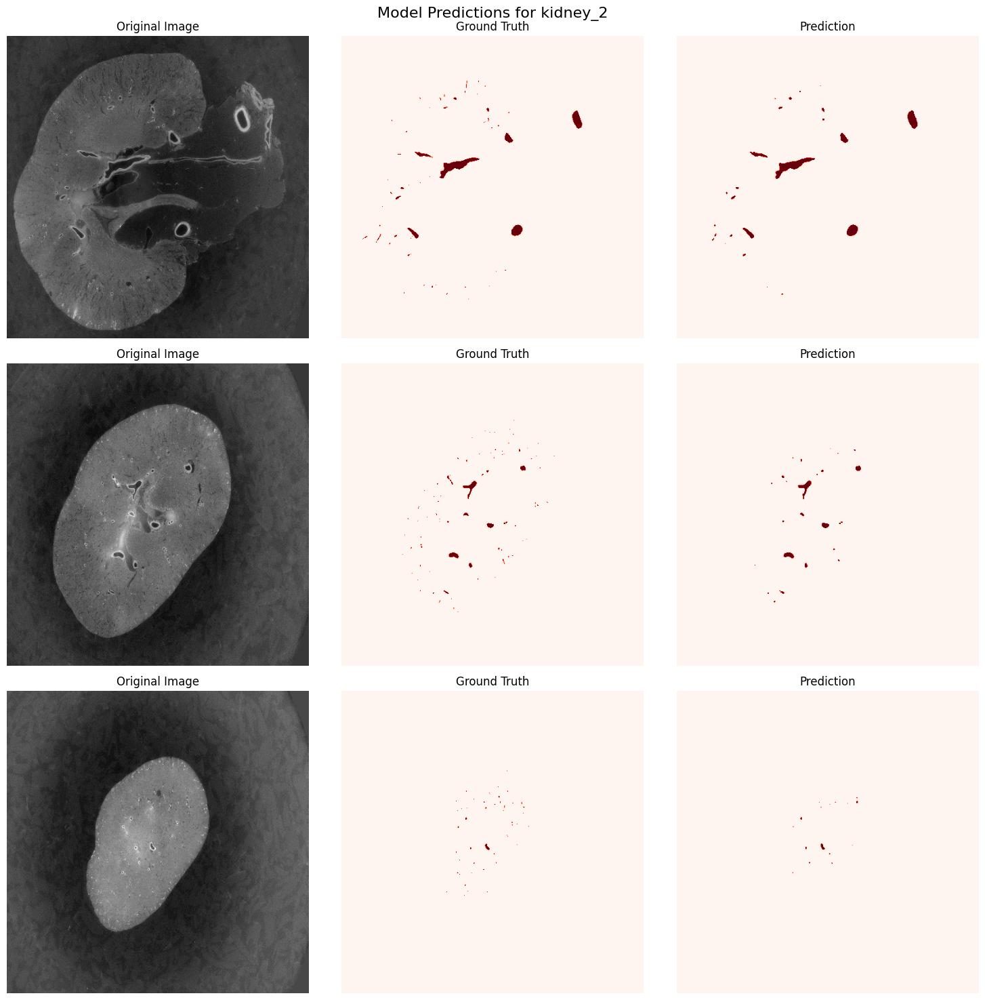


Visualizing predictions for kidney_3_sparse
Looking for model at: /kaggle/working/safer_improved_training_results_20250227_013459/kidney_3_sparse/best_model.pth
Loaded model with Best Dice: 0.7463


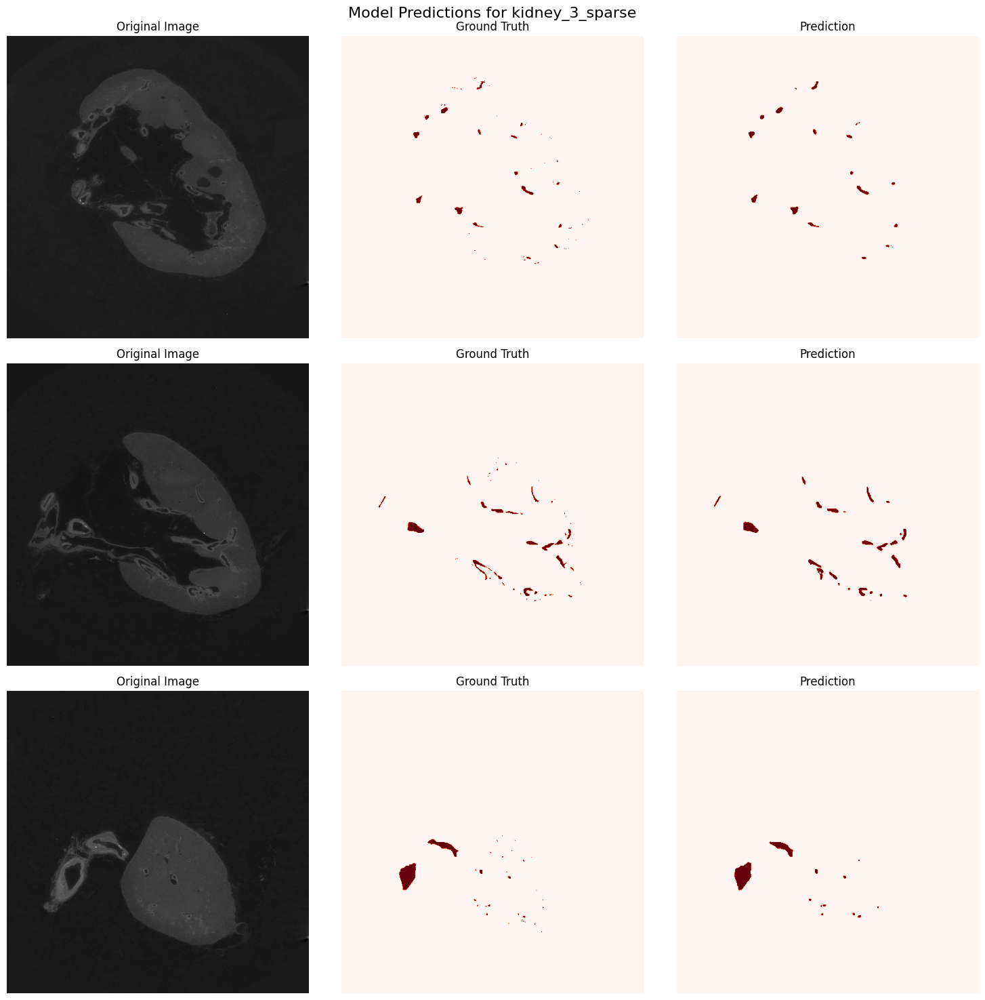

In [50]:
def main():
    """
    Main function to visualize predictions for all datasets
    """
    try:
        print("Starting visualization...")
        
        # Load dataloaders
        print("\nLoading dataloaders...")
        dataloader_path = Path('/kaggle/working/dataloader_info')
        dataloaders = load_and_recreate_dataloaders(dataloader_path)
        
        # Initialize model
        print("\nInitializing model...")
        model = ResNetUNet(n_classes=1)  # Using original ResNetUNet
        device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        model = model.to(device)
        
        # Find the latest training directory with a more flexible pattern
        training_dirs = list(Path('/kaggle/working').glob('*training_results_*'))
        if not training_dirs:
            raise ValueError("No training results directories found. Make sure you've run training first.")
        
        # Sort by modification time to get the latest
        latest_dir = max(training_dirs, key=lambda x: x.stat().st_mtime)
        print(f"\nUsing results from: {latest_dir}")
        
        # Visualize for each dataset
        for dataset_name, loaders in dataloaders.items():
            print(f"\nVisualizing predictions for {dataset_name}")
            
            # Load best model for this dataset
            model_path = latest_dir / dataset_name / 'best_model.pth'
            print(f"Looking for model at: {model_path}")
            
            if model_path.exists():
                try:
                    checkpoint = torch.load(model_path, map_location=device)
                    model.load_state_dict(checkpoint['model_state_dict'])
                    print(f"Loaded model with Best Dice: {checkpoint['best_dice']:.4f}")
                    
                    # Visualize predictions
                    visualize_predictions(
                        model=model,
                        dataset_name=dataset_name,
                        val_loader=loaders['val'],
                        device=device
                    )
                except Exception as e:
                    print(f"Error loading model for {dataset_name}: {str(e)}")
            else:
                print(f"No model found at {model_path}")
        
        # Clear memory
        del model
        gc.collect()
        if torch.cuda.is_available():
            torch.cuda.empty_cache()
            
    except Exception as e:
        print(f"Error in visualization: {str(e)}")
        import traceback
        traceback.print_exc()

if __name__ == "__main__":
    main()

# Segmentation

In [51]:
def segment_and_visualize(model, image_tensor, device):
    """
    Enhanced segmentation visualization with probability map
    """
    model.eval()
    with torch.no_grad():
        # Move image to device and get prediction
        image = image_tensor.to(device)
        output = model(image.unsqueeze(0))
        prediction = (output > 0.5).float()
        probability = output.cpu().squeeze().numpy()  # Get raw probability
        
        # Convert to numpy for visualization
        original = image.cpu().squeeze().numpy()
        segmentation = prediction.cpu().squeeze().numpy()
        
        # Create overlay with alpha based on probability
        overlay = np.zeros((*original.shape, 3))
        overlay[..., 0] = original  # Gray channel
        overlay[..., 1] = original  # Gray channel
        overlay[..., 2] = original  # Gray channel
        
        # Create probability-weighted mask (red for vessels, more intense = higher probability)
        prob_mask = np.zeros((*original.shape, 4))  # RGBA
        prob_mask[..., 0] = 1.0  # Red channel
        prob_mask[..., 3] = probability  # Alpha channel based on probability
        
        # Add red highlight for segmented vessels
        mask_region = segmentation > 0
        overlay[mask_region, 0] = 1.0  # Red channel
        overlay[mask_region, 1] = 0.0  # Green channel
        overlay[mask_region, 2] = 0.0  # Blue channel
        
        return original, segmentation, probability, overlay

In [55]:
def perform_vessel_segmentation(model, dataset_name, val_loader, device, num_samples=3):
    """
    Perform and visualize vessel segmentation with probability maps
    """
    # Get random batch
    dataiter = iter(val_loader)
    images, ground_truth = next(dataiter)
    
    # Select random indices
    batch_size = images.size(0)
    indices = random.sample(range(batch_size), min(num_samples, batch_size))
    
    # Create figure
    fig, axes = plt.subplots(num_samples, 5, figsize=(25, 5*num_samples))
    fig.suptitle(f'Enhanced Blood Vessel Segmentation Results for {dataset_name}', fontsize=16)
    
    for idx, sample_idx in enumerate(indices):
        image = images[sample_idx]
        gt_mask = ground_truth[sample_idx]
        
        # Get segmentation results
        original, segmentation, probability, overlay = segment_and_visualize(model, image, device)
        
        # Display results
        # Original image
        axes[idx, 0].imshow(original, cmap='gray')
        axes[idx, 0].set_title('Original Image')
        axes[idx, 0].axis('off')
        
        # Ground truth
        axes[idx, 1].imshow(gt_mask.squeeze().cpu().numpy(), cmap='Reds')
        axes[idx, 1].set_title('Ground Truth Vessels')
        axes[idx, 1].axis('off')
        
        # Probability map
        axes[idx, 2].imshow(probability, cmap='hot')
        axes[idx, 2].set_title('Probability Map')
        axes[idx, 2].axis('off')
        
        # Segmented vessels
        axes[idx, 3].imshow(segmentation, cmap='Reds')
        axes[idx, 3].set_title('Segmented Vessels')
        axes[idx, 3].axis('off')
        
        # Vessel overlay
        axes[idx, 4].imshow(overlay)
        axes[idx, 4].set_title('Vessel Overlay')
        axes[idx, 4].axis('off')
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    plt.show()
    plt.close()

Starting enhanced vessel segmentation visualization...

Loading dataloaders...
Dataset: Original dimensions: 1303x912, Target dimensions: 512x512
Dataset: Original dimensions: 1303x912, Target dimensions: 512x512
Dataset: Original dimensions: 1928x1928, Target dimensions: 512x512
Dataset: Original dimensions: 1928x1928, Target dimensions: 512x512
Dataset: Original dimensions: 1041x1511, Target dimensions: 512x512
Dataset: Original dimensions: 1041x1511, Target dimensions: 512x512
Dataset: Original dimensions: 1706x1510, Target dimensions: 512x512
Dataset: Original dimensions: 1706x1510, Target dimensions: 512x512

Initializing model...

Using models from: /kaggle/working/safer_improved_training_results_20250227_013459

Processing kidney_1_dense
Loading model from: /kaggle/working/safer_improved_training_results_20250227_013459/kidney_1_dense/best_model.pth
Loaded model with Best Dice: 0.7950
Performing enhanced vessel segmentation...


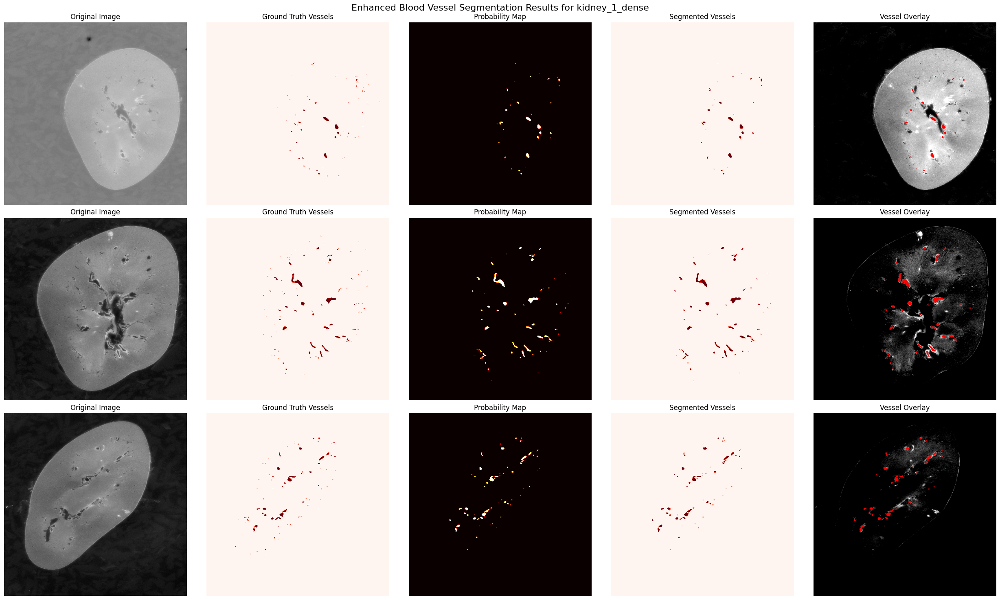


Processing kidney_1_voi
Loading model from: /kaggle/working/safer_improved_training_results_20250227_013459/kidney_1_voi/best_model.pth
Loaded model with Best Dice: 0.9398
Performing enhanced vessel segmentation...


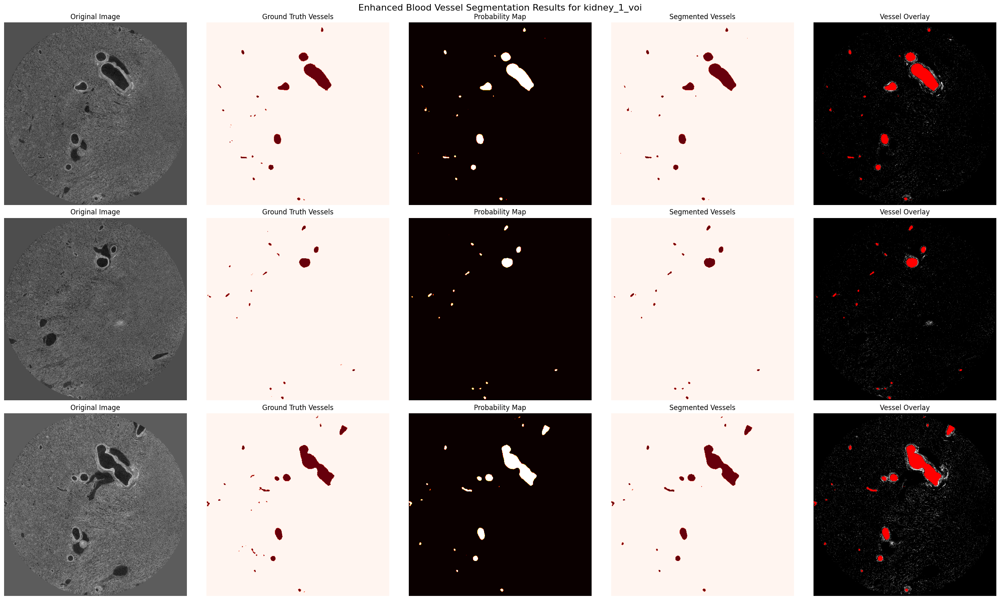


Processing kidney_2
Loading model from: /kaggle/working/safer_improved_training_results_20250227_013459/kidney_2/best_model.pth
Loaded model with Best Dice: 0.8565
Performing enhanced vessel segmentation...


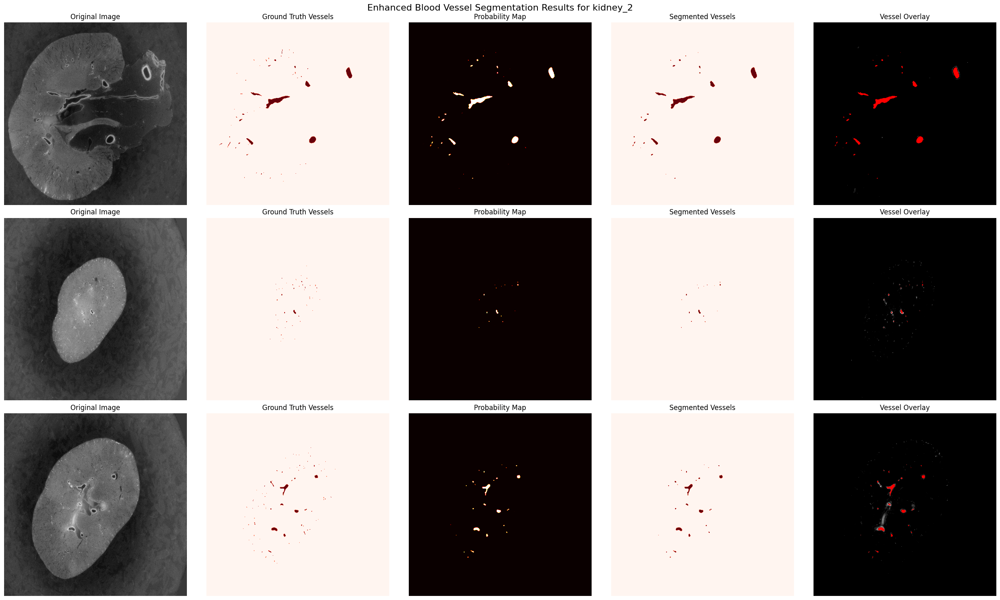


Processing kidney_3_sparse
Loading model from: /kaggle/working/safer_improved_training_results_20250227_013459/kidney_3_sparse/best_model.pth
Loaded model with Best Dice: 0.7463
Performing enhanced vessel segmentation...


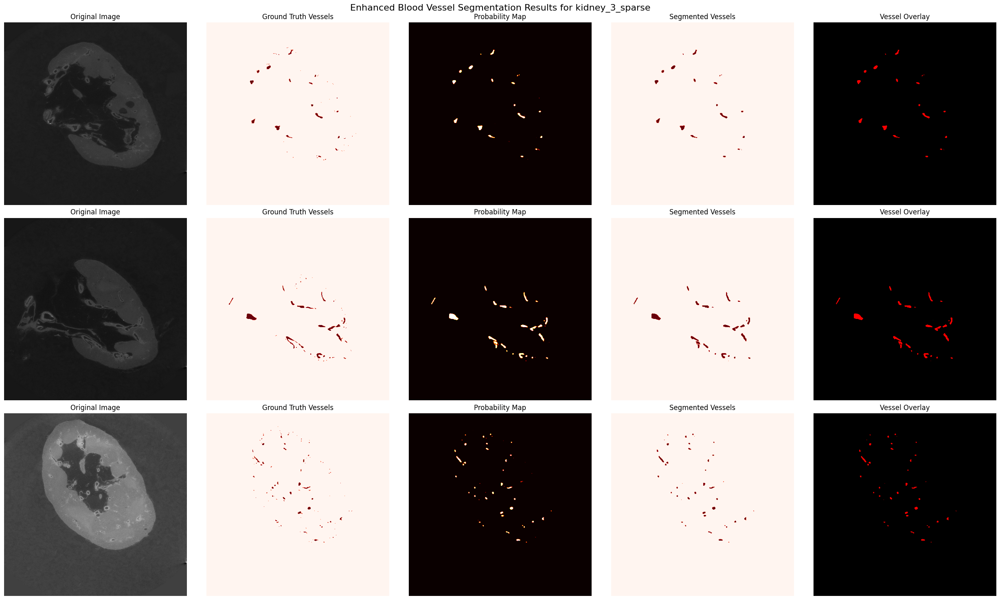


Enhanced vessel segmentation visualization completed!


In [56]:
def visualization_main():
    """
    Main function to perform enhanced vessel segmentation visualization on all datasets
    """
    try:
        print("Starting enhanced vessel segmentation visualization...")
        
        # Load dataloaders
        print("\nLoading dataloaders...")
        dataloader_path = Path('/kaggle/working/dataloader_info')
        dataloaders = load_and_recreate_dataloaders(dataloader_path)
        
        # Initialize model
        print("\nInitializing model...")
        model = ResNetUNet(n_classes=1)
        device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        model = model.to(device)
        
        # Find the latest training directory with a more flexible pattern
        training_dirs = list(Path('/kaggle/working').glob('*training_results_*'))
        if not training_dirs:
            raise ValueError("No training results directories found. Make sure you've run training first.")
        
        # Sort by modification time to get the latest
        latest_dir = max(training_dirs, key=lambda x: x.stat().st_mtime)
        print(f"\nUsing models from: {latest_dir}")
        
        # Process each dataset
        for dataset_name, loaders in dataloaders.items():
            print(f"\nProcessing {dataset_name}")
            
            # Check for regular model
            model_path = latest_dir / dataset_name / 'best_model.pth'
            
            print(f"Loading model from: {model_path}")
            
            if model_path.exists():
                try:
                    # Load model weights
                    checkpoint = torch.load(model_path, map_location=device)
                    model.load_state_dict(checkpoint['model_state_dict'])
                    print(f"Loaded model with Best Dice: {checkpoint['best_dice']:.4f}")
                    
                    # Perform enhanced segmentation
                    print("Performing enhanced vessel segmentation...")
                    perform_vessel_segmentation(
                        model=model,
                        dataset_name=dataset_name,
                        val_loader=loaders['val'],
                        device=device
                    )
                except Exception as e:
                    print(f"Error processing {dataset_name}: {str(e)}")
            else:
                print(f"No model found at {model_path}")
            
            # Clear memory
            gc.collect()
            if torch.cuda.is_available():
                torch.cuda.empty_cache()
        
        print("\nEnhanced vessel segmentation visualization completed!")
        
    except Exception as e:
        print(f"Error in enhanced vessel segmentation: {str(e)}")
        import traceback
        traceback.print_exc()

if __name__ == "__main__":
    visualization_main()

# Segmentation (Surface Dice)

Starting vessel segmentation based on best Surface Dice...

Loading dataloaders...
Dataset: Original dimensions: 1303x912, Target dimensions: 512x512
Dataset: Original dimensions: 1303x912, Target dimensions: 512x512
Dataset: Original dimensions: 1928x1928, Target dimensions: 512x512
Dataset: Original dimensions: 1928x1928, Target dimensions: 512x512
Dataset: Original dimensions: 1041x1511, Target dimensions: 512x512
Dataset: Original dimensions: 1041x1511, Target dimensions: 512x512
Dataset: Original dimensions: 1706x1510, Target dimensions: 512x512
Dataset: Original dimensions: 1706x1510, Target dimensions: 512x512

Initializing model...

Using models from: /kaggle/working/safer_improved_training_results_20250227_013459

Processing kidney_1_dense
Found model with Best Dice: 0.7950 and Best Surface Dice: 0.7427
Performing vessel segmentation using best Surface Dice model...


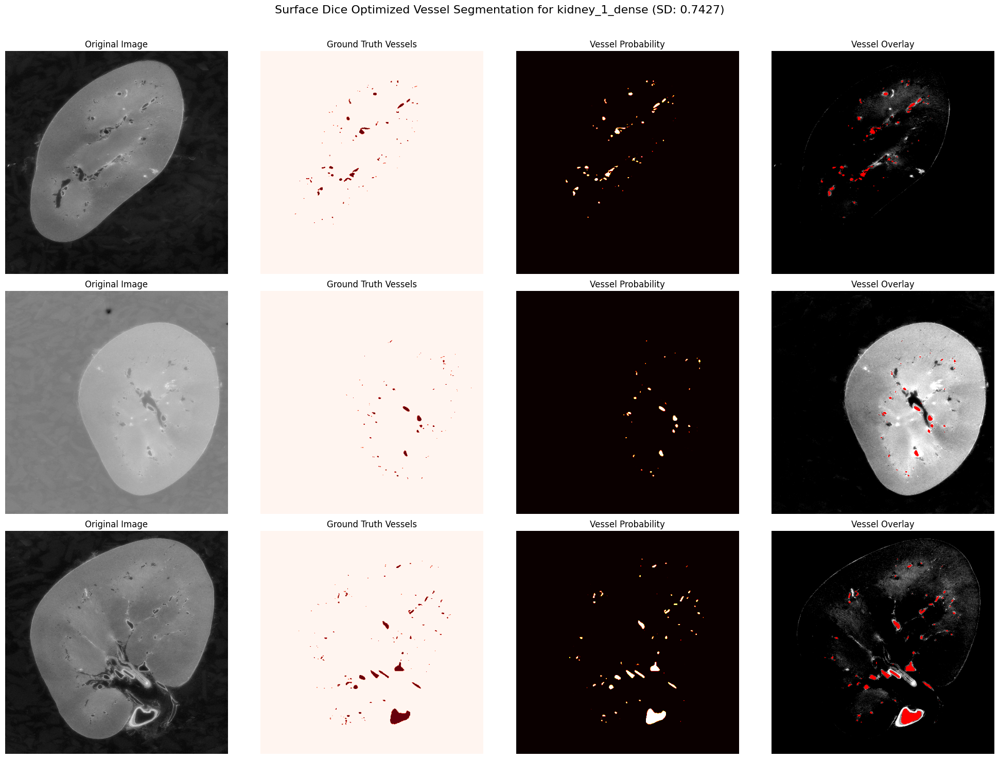


Processing kidney_1_voi
Found model with Best Dice: 0.9398 and Best Surface Dice: 0.9076
Performing vessel segmentation using best Surface Dice model...


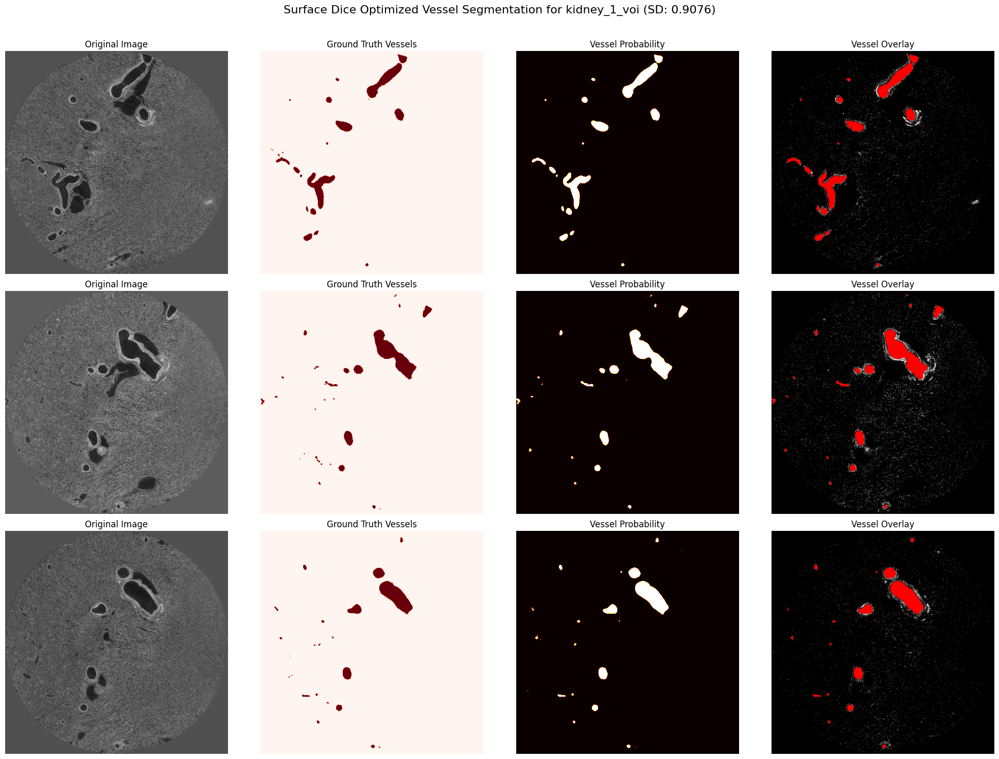


Processing kidney_2
Found model with Best Dice: 0.8565 and Best Surface Dice: 0.8169
Performing vessel segmentation using best Surface Dice model...


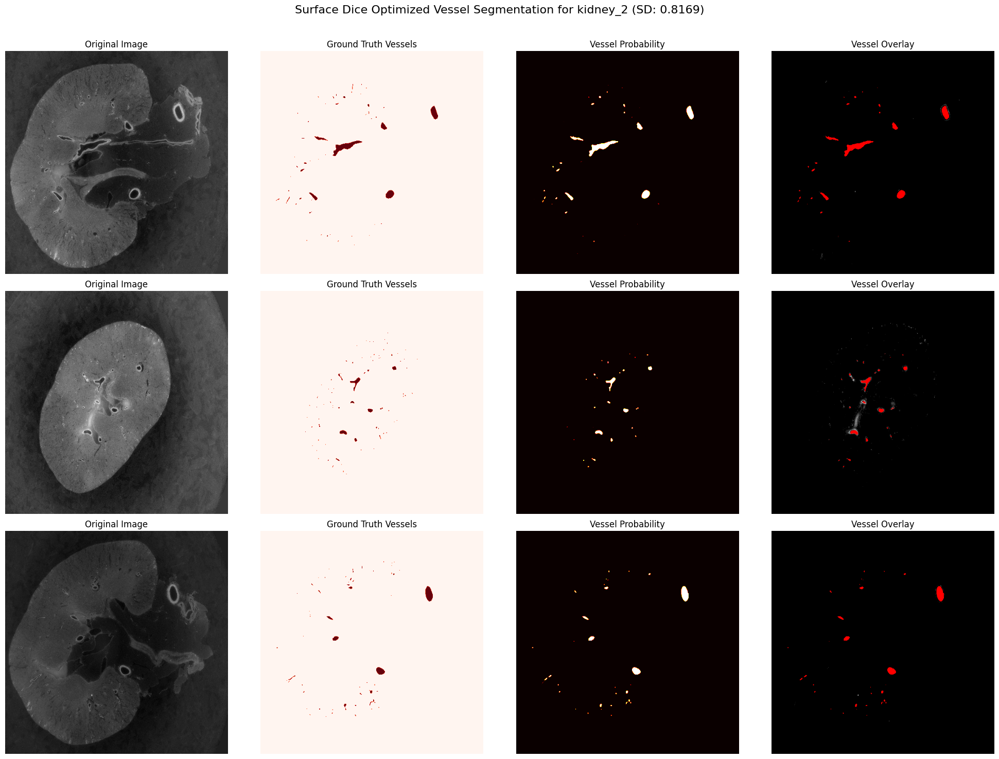


Processing kidney_3_sparse
Found model with Best Dice: 0.7463 and Best Surface Dice: 0.7647
Performing vessel segmentation using best Surface Dice model...


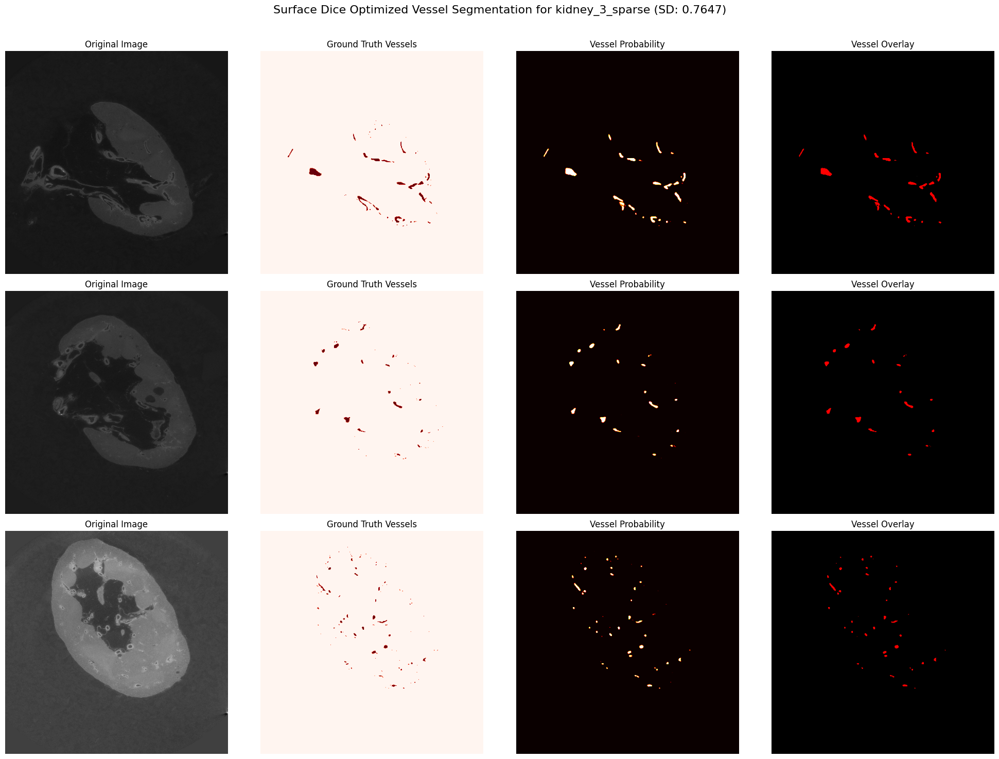


Surface Dice based vessel segmentation completed!


In [57]:
def visualize_using_surface_dice():
    """
    Visualization function that uses models with best Surface Dice instead of best Dice
    """
    try:
        print("Starting vessel segmentation based on best Surface Dice...")
        
        # Load dataloaders
        print("\nLoading dataloaders...")
        dataloader_path = Path('/kaggle/working/dataloader_info')
        dataloaders = load_and_recreate_dataloaders(dataloader_path)
        
        # Initialize model
        print("\nInitializing model...")
        model = ResNetUNet(n_classes=1)
        device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        model = model.to(device)
        
        # Find the latest training directory
        training_dirs = list(Path('/kaggle/working').glob('*training_results_*'))
        if not training_dirs:
            raise ValueError("No training results directories found. Make sure you've run training first.")
        
        # Sort by modification time to get the latest
        latest_dir = max(training_dirs, key=lambda x: x.stat().st_mtime)
        print(f"\nUsing models from: {latest_dir}")
        
        # Process each dataset
        for dataset_name, loaders in dataloaders.items():
            print(f"\nProcessing {dataset_name}")
            
            # Check for best model
            model_path = latest_dir / dataset_name / 'best_model.pth'
            
            if model_path.exists():
                try:
                    # Load checkpoint and check metrics
                    checkpoint = torch.load(model_path, map_location=device)
                    best_dice = checkpoint['best_dice']
                    best_surface_dice = checkpoint['best_surface_dice']
                    
                    print(f"Found model with Best Dice: {best_dice:.4f} and Best Surface Dice: {best_surface_dice:.4f}")
                    
                    # Load model weights
                    model.load_state_dict(checkpoint['model_state_dict'])
                    
                    # Perform enhanced segmentation
                    print("Performing vessel segmentation using best Surface Dice model...")
                    
                    # Create figure title highlighting Surface Dice
                    title = f'Surface Dice Optimized Vessel Segmentation for {dataset_name} (SD: {best_surface_dice:.4f})'
                    
                    # Get random batch
                    dataiter = iter(loaders['val'])
                    images, ground_truth = next(dataiter)
                    
                    # Select random indices
                    batch_size = images.size(0)
                    num_samples = 3
                    indices = random.sample(range(batch_size), min(num_samples, batch_size))
                    
                    # Create figure
                    fig, axes = plt.subplots(num_samples, 4, figsize=(20, 5*num_samples))
                    fig.suptitle(title, fontsize=16)
                    
                    for idx, sample_idx in enumerate(indices):
                        image = images[sample_idx]
                        gt_mask = ground_truth[sample_idx]
                        
                        # Get segmentation results
                        original, segmentation, probability, overlay = segment_and_visualize(model, image, device)
                        
                        # Display results
                        # Original image
                        axes[idx, 0].imshow(original, cmap='gray')
                        axes[idx, 0].set_title('Original Image')
                        axes[idx, 0].axis('off')
                        
                        # Ground truth
                        axes[idx, 1].imshow(gt_mask.squeeze().cpu().numpy(), cmap='Reds')
                        axes[idx, 1].set_title('Ground Truth Vessels')
                        axes[idx, 1].axis('off')
                        
                        # Probability map
                        axes[idx, 2].imshow(probability, cmap='hot')
                        axes[idx, 2].set_title('Vessel Probability')
                        axes[idx, 2].axis('off')
                        
                        # Overlay
                        axes[idx, 3].imshow(overlay)
                        axes[idx, 3].set_title('Vessel Overlay')
                        axes[idx, 3].axis('off')
                    
                    plt.tight_layout()
                    plt.subplots_adjust(top=0.92)
                    plt.show()
                    plt.close()
                    
                except Exception as e:
                    print(f"Error processing {dataset_name}: {str(e)}")
                    traceback.print_exc()
            else:
                print(f"No model found at {model_path}")
            
            # Clear memory
            gc.collect()
            if torch.cuda.is_available():
                torch.cuda.empty_cache()
        
        print("\nSurface Dice based vessel segmentation completed!")
        
    except Exception as e:
        print(f"Error in vessel segmentation: {str(e)}")
        import traceback
        traceback.print_exc()

if __name__ == "__main__":
    visualize_using_surface_dice()